<a href="https://colab.research.google.com/github/jeswitha2003/Autonomous-Vehicle-Safety-Analysis-using-nuScenes-Dataset-TTC-Distance-Collision-Risk-Prediction-/blob/main/Autonomous_Vehicle_Risk_Detection_using_Nuscenes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install nuscenes-devkit pyyaml


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.3 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of opencv-python-headless to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.0/316.0 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 75.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.0/50.0 MB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 64.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.9/115.9 kB 8.2 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: Shapely
    Found existing installation: shapely 2.1.2
    Uninstalling shapely-2.1.2:
      Successfully uninstalled shapely-2.1.2
  Attempting uninstall: opencv-python-headless
    Found exis

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from nuscenes.nuscenes import NuScenes

data_path = '/content/drive/MyDrive/datasets/nuscenes'
nusc = NuScenes(version='v1.0-mini', dataroot=data_path, verbose=True)


Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 5.611 seconds.
Reverse indexing ...
Done reverse indexing in 0.1 seconds.


In [ ]:
from nuscenes.nuscenes import NuScenes

data_path = '/content/drive/MyDrive/v1.0-mini (1).tgz'
nusc = NuScenes(version='v1.0-mini (1)', dataroot=data_path, verbose=True)


AssertionError: Database version not found: /content/drive/MyDrive/v1.0-mini (1).tgz/v1.0-mini (1)

In [ ]:
print("Number of scenes:", len(nusc.scene))


Number of scenes: 10


In [ ]:
nusc.scene[0]


{'token': 'cc8c0bf57f984915a77078b10eb33198',
 'log_token': '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
 'nbr_samples': 39,
 'first_sample_token': 'ca9a282c9e77460f8360f564131a8af5',
 'last_sample_token': 'ed5fc18c31904f96a8f0dbb99ff069c0',
 'name': 'scene-0061',
 'description': 'Parked truck, construction, intersection, turn left, following a van'}

In [ ]:
print("Total sample_data entries:", len(nusc.sample_data))


Total sample_data entries: 31206


In [ ]:
from collections import Counter
Counter([sd['channel'] for sd in nusc.sample_data])


Counter({'RADAR_FRONT': 2635,
         'RADAR_FRONT_LEFT': 2686,
         'RADAR_FRONT_RIGHT': 2673,
         'RADAR_BACK_LEFT': 2634,
         'RADAR_BACK_RIGHT': 2635,
         'LIDAR_TOP': 3935,
         'CAM_FRONT': 2342,
         'CAM_FRONT_RIGHT': 2338,
         'CAM_BACK_RIGHT': 2342,
         'CAM_BACK': 2315,
         'CAM_BACK_LEFT': 2327,
         'CAM_FRONT_LEFT': 2344})

In [ ]:
print("Total object annotations:", len(nusc.sample_annotation))


Total object annotations: 18538


In [ ]:
categories = [c['name'] for c in nusc.category]
categories


['human.pedestrian.adult',
 'human.pedestrian.child',
 'human.pedestrian.wheelchair',
 'human.pedestrian.stroller',
 'human.pedestrian.personal_mobility',
 'human.pedestrian.police_officer',
 'human.pedestrian.construction_worker',
 'animal',
 'vehicle.car',
 'vehicle.motorcycle',
 'vehicle.bicycle',
 'vehicle.bus.bendy',
 'vehicle.bus.rigid',
 'vehicle.truck',
 'vehicle.construction',
 'vehicle.emergency.ambulance',
 'vehicle.emergency.police',
 'vehicle.trailer',
 'movable_object.barrier',
 'movable_object.trafficcone',
 'movable_object.pushable_pullable',
 'movable_object.debris',
 'static_object.bicycle_rack']

In [ ]:
!rm -rf /content/drive/MyDrive/datasets/nuscenes


KeyboardInterrupt: 

In [ ]:
!mkdir -p /content/drive/MyDrive/datasets/nuscenes


In [ ]:
!tar -xzf /content/drive/MyDrive/v1.0-mini.tgz -C /content/drive/MyDrive/datasets/nuscenes


^C


In [ ]:
!ls /content/drive/MyDrive/datasets/nuscenes


LICENSE  maps  samples	sweeps	v1.0-mini


In [ ]:
!pip install nuscenes-devkit pyyaml


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.2 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of opencv-python-headless to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.0/316.0 kB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 70.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.0/50.0 MB 18.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 82.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.9/115.9 kB 8.6 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: Shapely
    Found existing installation: shapely 2.1.2
    Uninstalling shapely-2.1.2:
      Successfully uninstalled shapely-2.1.2
  Attempting uninstall: opencv-python-headless
    Found exis

In [ ]:
import pandas as pd


In [ ]:
rows = []

for ann in nusc.sample_annotation:
    sample_token = ann['sample_token']
    category = ann['category_name']
    x, y, z = ann['translation']
    rot_x, rot_y, rot_z, rot_w = ann['rotation']
    instance_token = ann['instance_token']
    scene_token = nusc.get('sample', sample_token)['scene_token']

    rows.append({
        'sample_token': sample_token,
        'scene_token': scene_token,
        'instance_token': instance_token,
        'category': category,
        'x': x,
        'y': y,
        'z': z,
        'rot_w': rot_w,
        'rot_x': rot_x,
        'rot_y': rot_y,
        'rot_z': rot_z
    })

df_annotations = pd.DataFrame(rows)
df_annotations.head()


,sample_token,scene_token,instance_token,category,x,y,z,rot_w,rot_x,rot_y,rot_z
0,cd21dbfc3bd749c7b10a5c42562e0c42,cc8c0bf57f984915a77078b10eb33198,6dd2cbf4c24b4caeb625035869bca7b5,human.pedestrian.adult,373.214,1130.480,1.250,-0.183016,0.98311,0.0,0.0
1,2ff86dc19c4644a1a88ce5ba848f56e5,cc8c0bf57f984915a77078b10eb33198,6dd2cbf4c24b4caeb625035869bca7b5,human.pedestrian.adult,373.152,1130.357,1.250,-0.183016,0.98311,0.0,0.0
2,29e056fc277543c9bc42310b122c640e,cc8c0bf57f984915a77078b10eb33198,6dd2cbf4c24b4caeb625035869bca7b5,human.pedestrian.adult,373.350,1130.670,1.123,-0.183016,0.98311,0.0,0.0
3,ca9a282c9e77460f8360f564131a8af5,cc8c0bf57f984915a77078b10eb33198,6dd2cbf4c24b4caeb625035869bca7b5,human.pedestrian.adult,373.256,1130.419,0.800,-0.183016,0.98311,0.0,0.0
4,39586f9d59004284a7114a68825e8eec,cc8c0bf57f984915a77078b10eb33198,6dd2cbf4c24b4caeb625035869bca7b5,human.pedestrian.adult,373.256,1130.419,0.810,-0.183016,0.98311,0.0,0.0


In [ ]:
df_annotations['category'].value_counts()


,count
category,
vehicle.car,7619
human.pedestrian.adult,4765
movable_object.barrier,2323
movable_object.trafficcone,1378
vehicle.truck,649
vehicle.motorcycle,471
vehicle.bus.rigid,353
vehicle.bicycle,243
vehicle.construction,196


In [ ]:
vehicles = df_annotations[df_annotations['category'].str.contains('vehicle')]
vehicles.head()


,sample_token,scene_token,instance_token,category,x,y,z,rot_w,rot_x,rot_y,rot_z
69,ca9a282c9e77460f8360f564131a8af5,cc8c0bf57f984915a77078b10eb33198,bd26c2cdb22d4bb1834e808c89128898,vehicle.car,353.794,1132.355,0.602,-0.200334,0.979728,0.0,0.0
70,be99ffc878b24aca8956bbb4e0f97d0c,cc8c0bf57f984915a77078b10eb33198,bd26c2cdb22d4bb1834e808c89128898,vehicle.car,353.830,1132.369,0.737,-0.200334,0.979728,0.0,0.0
71,2afb9d32310e4546a71cbe432911eca2,cc8c0bf57f984915a77078b10eb33198,bd26c2cdb22d4bb1834e808c89128898,vehicle.car,353.900,1132.339,0.916,-0.191777,0.981439,0.0,0.0
72,b26e791522294bec90f86fd72226e35c,cc8c0bf57f984915a77078b10eb33198,bd26c2cdb22d4bb1834e808c89128898,vehicle.car,354.091,1132.468,1.216,-0.191777,0.981439,0.0,0.0
73,fedfb3a6cb804635a0f47143f9ca8d6f,cc8c0bf57f984915a77078b10eb33198,bd26c2cdb22d4bb1834e808c89128898,vehicle.car,354.104,1132.795,1.367,-0.191777,0.981439,0.0,0.0


In [ ]:
vehicles_per_scene = vehicles.groupby('scene_token').size().reset_index(name='vehicle_count')
vehicles_per_scene


,scene_token,vehicle_count
0,2fc3753772e241f2ab2cd16a784cc680,459
1,325cef682f064c55a255f2625c533b75,1979
2,6f83169d067343658251f72e1dd17dbc,852
3,bebf5f5b2a674631ab5c88fd1aa9e87a,1986
4,c5224b9b454b4ded9b5d2d2634bbda8a,547
5,cc8c0bf57f984915a77078b10eb33198,728
6,d25718445d89453381c659b9c8734939,764
7,de7d80a1f5fb4c3e82ce8a4f213b450a,714
8,e233467e827140efa4b42d2b4c435855,554
9,fcbccedd61424f1b85dcbf8f897f9754,1065


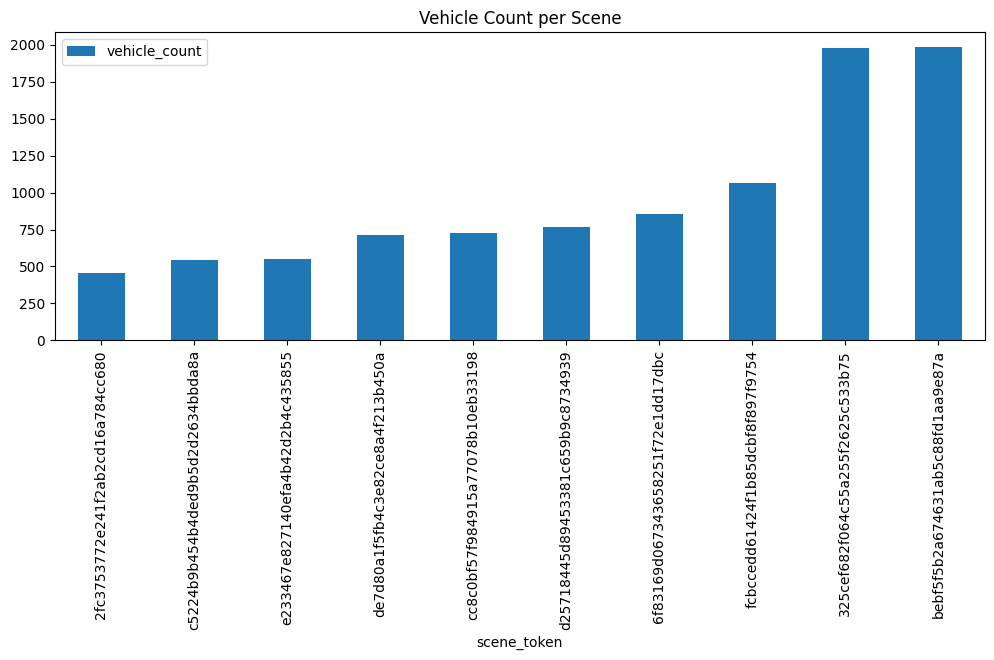

In [ ]:
import matplotlib.pyplot as plt

vehicles_per_scene.sort_values('vehicle_count').plot(
    x='scene_token',
    y='vehicle_count',
    kind='bar',
    figsize=(12,4)
)
plt.title('Vehicle Count per Scene')
plt.show()


In [ ]:
trajectories = []

for ann in nusc.sample_annotation:
    instance_token = ann['instance_token']
    sample_token = ann['sample_token']
    category = ann['category_name']

    # Position
    x, y, z = ann['translation']

    # Rotation
    rot_x, rot_y, rot_z, rot_w = ann['rotation']

    # Find scene and timestamp
    sample = nusc.get('sample', sample_token)
    scene_token = sample['scene_token']

    # Get timestamp from a camera (CAM_FRONT) to make sure it's aligned
    cam_token = sample['data']['CAM_FRONT']
    timestamp = nusc.get('sample_data', cam_token)['timestamp']

    trajectories.append({
        'instance_token': instance_token,
        'sample_token': sample_token,
        'scene_token': scene_token,
        'timestamp': timestamp,
        'category': category,
        'x': x,
        'y': y,
        'z': z,
        'rot_x': rot_x,
        'rot_y': rot_y,
        'rot_z': rot_z,
        'rot_w': rot_w
    })

df_traj = pd.DataFrame(trajectories)
df_traj.head()




,instance_token,sample_token,scene_token,timestamp,category,x,y,z,rot_x,rot_y,rot_z,rot_w
0,6dd2cbf4c24b4caeb625035869bca7b5,cd21dbfc3bd749c7b10a5c42562e0c42,cc8c0bf57f984915a77078b10eb33198,1532402935162463,human.pedestrian.adult,373.214,1130.480,1.250,0.98311,0.0,0.0,-0.183016
1,6dd2cbf4c24b4caeb625035869bca7b5,2ff86dc19c4644a1a88ce5ba848f56e5,cc8c0bf57f984915a77078b10eb33198,1532402936162460,human.pedestrian.adult,373.152,1130.357,1.250,0.98311,0.0,0.0,-0.183016
2,6dd2cbf4c24b4caeb625035869bca7b5,29e056fc277543c9bc42310b122c640e,cc8c0bf57f984915a77078b10eb33198,1532402946262460,human.pedestrian.adult,373.350,1130.670,1.123,0.98311,0.0,0.0,-0.183016
3,6dd2cbf4c24b4caeb625035869bca7b5,ca9a282c9e77460f8360f564131a8af5,cc8c0bf57f984915a77078b10eb33198,1532402927612460,human.pedestrian.adult,373.256,1130.419,0.800,0.98311,0.0,0.0,-0.183016
4,6dd2cbf4c24b4caeb625035869bca7b5,39586f9d59004284a7114a68825e8eec,cc8c0bf57f984915a77078b10eb33198,1532402928112460,human.pedestrian.adult,373.256,1130.419,0.810,0.98311,0.0,0.0,-0.183016


In [ ]:
df_traj = df_traj.sort_values(by=['instance_token', 'timestamp'])


In [ ]:
df_traj['delta_x'] = df_traj.groupby('instance_token')['x'].diff()
df_traj['delta_y'] = df_traj.groupby('instance_token')['y'].diff()
df_traj['delta_t'] = df_traj.groupby('instance_token')['timestamp'].diff()

df_traj['speed_m_per_s'] = (
    ((df_traj['delta_x']**2 + df_traj['delta_y']**2)**0.5) / (df_traj['delta_t'] / 1e6)
)


In [ ]:
df_vehicle_traj = df_traj[df_traj['category'].str.contains('vehicle')]


In [ ]:
unique_vehicles = df_vehicle_traj['instance_token'].unique()
unique_vehicles[:10]


array(['001e8066b25640af889db54db4c12c45',
       '007842c92eaf4351b5a9678f7e7094f3',
       '00d5f1e688a64d5ca65a739fbc60dae6',
       '00db277903e1499589d576b7d0427ba5',
       '026dcf49ee9a46859c8db4183138638e',
       '041b9e3abcab4e5c8c3eded8054415cb',
       '045cd82a77a1472499e8c15100cb5ff3',
       '056d745eca7b42f493d84cc2b7d3b5dc',
       '0633f89a039a4e05bf60e53b57d1129d',
       '06b2c1a728c54165838673a743dc5017'], dtype=object)

In [ ]:
instance_id = unique_vehicles[0]


In [ ]:
single_traj = df_vehicle_traj[df_vehicle_traj['instance_token'] == instance_id]
single_traj.head()


,instance_token,sample_token,scene_token,timestamp,category,x,y,z,rot_x,rot_y,rot_z,rot_w,delta_x,delta_y,delta_t,speed_m_per_s
15553,001e8066b25640af889db54db4c12c45,d148d50ba9be44bcb2105d8da47425b4,d25718445d89453381c659b9c8734939,1542800378862460,vehicle.car,688.332,1906.355,1.135,0.349284,0.0,0.0,0.937017,NaN,NaN,NaN,NaN
15551,001e8066b25640af889db54db4c12c45,f2d48fe35d5646659dc339e1d36886f9,d25718445d89453381c659b9c8734939,1542800379362460,vehicle.car,683.265,1910.693,1.285,0.349284,0.0,0.0,0.937017,-5.067,4.338,500000.0,13.340575
15548,001e8066b25640af889db54db4c12c45,a32166aff42946d39455fcbe502a321a,d25718445d89453381c659b9c8734939,1542800379862460,vehicle.car,678.282,1915.127,1.285,0.349284,0.0,0.0,0.937017,-4.983,4.434,500000.0,13.340262
15546,001e8066b25640af889db54db4c12c45,7ca3502caf394d6d9c0a80b822b3ff48,d25718445d89453381c659b9c8734939,1542800380362460,vehicle.car,673.294,1919.567,1.285,0.365584,0.0,0.0,0.930779,-4.988,4.440,500000.0,13.355709
15549,001e8066b25640af889db54db4c12c45,5b77f438091b4d00a74d333ef2fe9033,d25718445d89453381c659b9c8734939,1542800380912460,vehicle.car,667.817,1924.352,1.485,0.365584,0.0,0.0,0.930779,-5.477,4.785,550000.0,13.223289


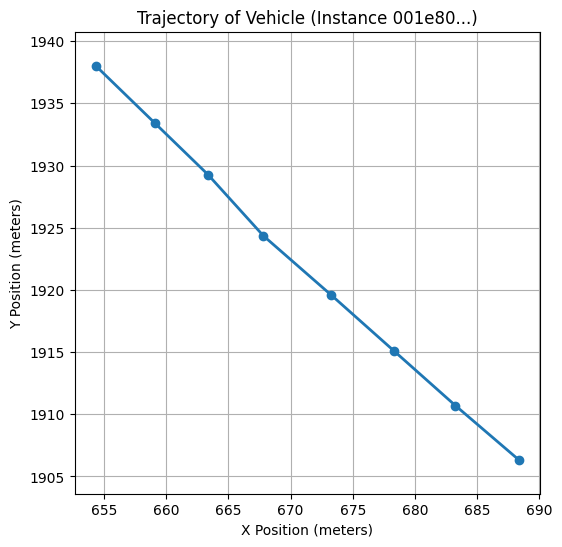

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(6,6))

plt.plot(single_traj['x'], single_traj['y'], marker='o', linestyle='-', linewidth=2)
plt.title(f"Trajectory of Vehicle (Instance {instance_id[:6]}...)")
plt.xlabel("X Position (meters)")
plt.ylabel("Y Position (meters)")
plt.grid(True)
plt.axis("equal")

plt.show()


In [ ]:
vehicle_positions = df_traj[df_traj['category'].str.contains('vehicle')]


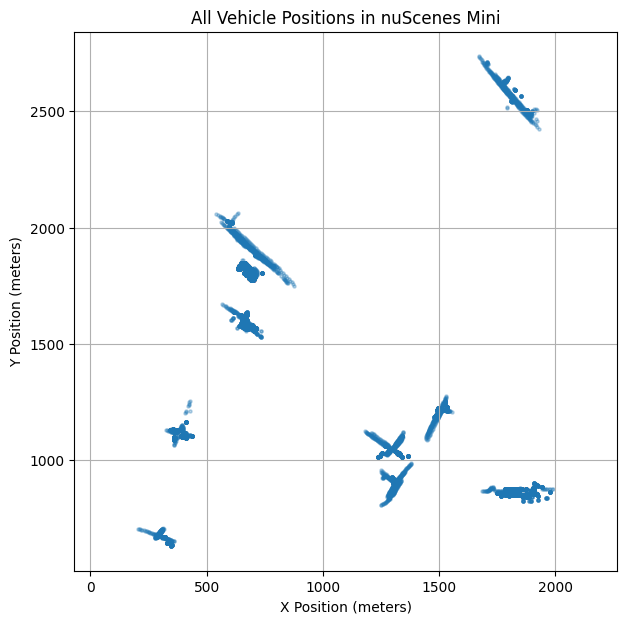

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(7,7))
plt.scatter(vehicle_positions['x'], vehicle_positions['y'], s=5, alpha=0.3)
plt.title('All Vehicle Positions in nuScenes Mini')
plt.xlabel('X Position (meters)')
plt.ylabel('Y Position (meters)')
plt.grid(True)
plt.axis('equal')
plt.show()


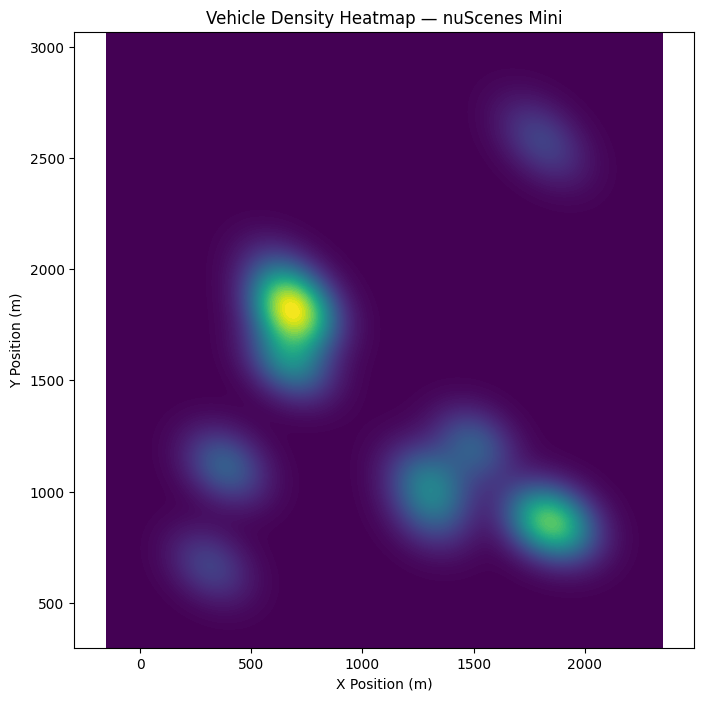

In [ ]:
import numpy as np
import seaborn as sns

plt.figure(figsize=(8,8))

# Create a 2D histogram (heatmap)
sns.kdeplot(
    x=vehicle_positions['x'],
    y=vehicle_positions['y'],
    fill=True,
    cmap="viridis",
    thresh=0,
    levels=100
)

plt.title("Vehicle Density Heatmap — nuScenes Mini")
plt.xlabel("X Position (m)")
plt.ylabel("Y Position (m)")
plt.axis('equal')
plt.show()


In [ ]:
vehicle_positions = df_traj[df_traj['category'].str.contains('vehicle')]

vehicles_per_scene = (
    vehicle_positions.groupby('scene_token')
    .size()
    .reset_index(name='vehicle_count')
)

vehicles_per_scene.head()


,scene_token,vehicle_count
0,2fc3753772e241f2ab2cd16a784cc680,459
1,325cef682f064c55a255f2625c533b75,1979
2,6f83169d067343658251f72e1dd17dbc,852
3,bebf5f5b2a674631ab5c88fd1aa9e87a,1986
4,c5224b9b454b4ded9b5d2d2634bbda8a,547


In [ ]:
scene_info = pd.DataFrame(nusc.scene)
scene_info = scene_info[['token', 'name']]
scene_info.columns = ['scene_token', 'scene_name']

vehicles_scene_named = vehicles_per_scene.merge(scene_info, on='scene_token')
vehicles_scene_named.head()


,scene_token,vehicle_count,scene_name
0,2fc3753772e241f2ab2cd16a784cc680,459,scene-0757
1,325cef682f064c55a255f2625c533b75,1979,scene-0916
2,6f83169d067343658251f72e1dd17dbc,852,scene-0553
3,bebf5f5b2a674631ab5c88fd1aa9e87a,1986,scene-0655
4,c5224b9b454b4ded9b5d2d2634bbda8a,547,scene-0796


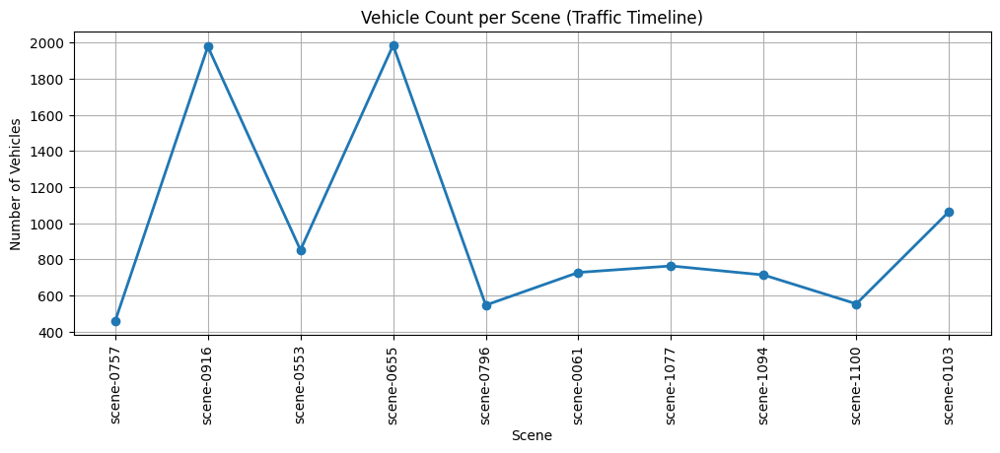

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12,4))
plt.plot(vehicles_scene_named['scene_name'], vehicles_scene_named['vehicle_count'], marker='o', linewidth=2)

plt.xticks(rotation=90)
plt.title("Vehicle Count per Scene (Traffic Timeline)")
plt.xlabel("Scene")
plt.ylabel("Number of Vehicles")
plt.grid(True)
plt.show()


In [ ]:
df_speed = df_traj.copy()

df_speed = df_speed[(df_speed['speed_m_per_s'].notna()) &
                    (df_speed['speed_m_per_s'] < 20)]   # remove outliers >20 m/s (~72 km/h)


In [ ]:
avg_speed_per_vehicle = (
    df_speed.groupby('instance_token')['speed_m_per_s']
    .mean()
    .reset_index(name='avg_speed')
)

avg_speed_per_vehicle.head()


,instance_token,avg_speed
0,001e8066b25640af889db54db4c12c45,13.282965
1,005855d523f84d8a9e3bef3031c93e56,1.325426
2,007842c92eaf4351b5a9678f7e7094f3,0.080012
3,007ed64e589545d1805aaf65467dc399,0.000000
4,00cfe5312e5e469bb97d7b64245a98e3,2.195246


In [ ]:
top10_fastest = avg_speed_per_vehicle.sort_values(by='avg_speed', ascending=False).head(10)
top10_fastest


,instance_token,avg_speed
303,553e556945f54168b75bc58c158afa8a,17.454755
250,437fe13d66554c51b1ea89f940e5bf4b,17.041606
596,b3551ff1bff84890a8ae2a3347715ff1,16.940706
601,b51a3d3cde35495fbac2bf37cb9f2c55,16.607764
402,775a0cb47a6d48ac98da930da99b2413,16.550772
456,88e4abb15ade4097a1689225c13399ec,15.938957
286,4d88977115ad461cbb7a0ec65792b816,15.273673
106,1e425c3c4d3c42848f29a7b5c46565e2,15.235297
237,4045908096574b24a57f32261d6a76a2,14.823500
358,69385845cb9747b7afe095177cc405b5,14.772496


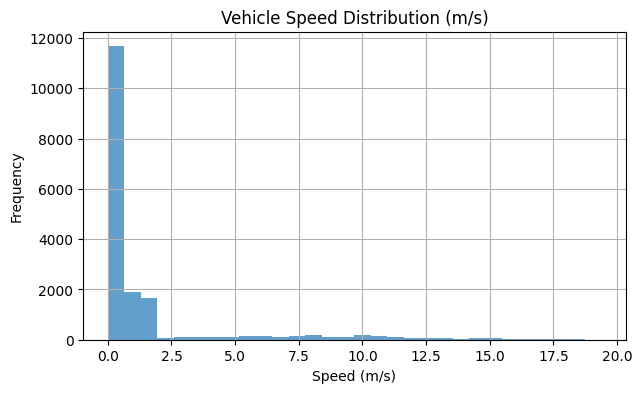

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(7,4))
plt.hist(df_speed['speed_m_per_s'], bins=30, alpha=0.7)
plt.title("Vehicle Speed Distribution (m/s)")
plt.xlabel("Speed (m/s)")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()


In [ ]:
df_speed['speed_kmph'] = df_speed['speed_m_per_s'] * 3.6


In [ ]:
sample = nusc.sample[0]
sample


{'token': 'ca9a282c9e77460f8360f564131a8af5',
 'timestamp': 1532402927647951,
 'prev': '',
 'next': '39586f9d59004284a7114a68825e8eec',
 'scene_token': 'cc8c0bf57f984915a77078b10eb33198',
 'data': {'RADAR_FRONT': '37091c75b9704e0daa829ba56dfa0906',
  'RADAR_FRONT_LEFT': '11946c1461d14016a322916157da3c7d',
  'RADAR_FRONT_RIGHT': '491209956ee3435a9ec173dad3aaf58b',
  'RADAR_BACK_LEFT': '312aa38d0e3e4f01b3124c523e6f9776',
  'RADAR_BACK_RIGHT': '07b30d5eb6104e79be58eadf94382bc1',
  'LIDAR_TOP': '9d9bf11fb0e144c8b446d54a8a00184f',
  'CAM_FRONT': 'e3d495d4ac534d54b321f50006683844',
  'CAM_FRONT_RIGHT': 'aac7867ebf4f446395d29fbd60b63b3b',
  'CAM_BACK_RIGHT': '79dbb4460a6b40f49f9c150cb118247e',
  'CAM_BACK': '03bea5763f0f4722933508d5999c5fd8',
  'CAM_BACK_LEFT': '43893a033f9c46d4a51b5e08a67a1eb7',
  'CAM_FRONT_LEFT': 'fe5422747a7d4268a4b07fc396707b23'},
 'anns': ['ef63a697930c4b20a6b9791f423351da',
  '6b89da9bf1f84fd6a5fbe1c3b236f809',
  '924ee6ac1fed440a9d9e3720aac635a0',
  '91e3608f55174a319

In [ ]:
!ls /content/drive/MyDrive/datasets/nuscenes/samples/


CAM_FRONT_RIGHT


In [ ]:
!ls -lh /content/drive/MyDrive/v1.0-mini\ \(1\).tgz


-rw------- 1 root root 3.9G Nov 15 00:22 '/content/drive/MyDrive/v1.0-mini (1).tgz'


In [ ]:
!rm -rf /content/drive/MyDrive/datasets/nuscenes
!mkdir -p /content/drive/MyDrive/datasets/nuscenes

!tar -xzf "/content/drive/MyDrive/v1.0-mini_meta.tgz"    -C /content/drive/MyDrive/datasets/nuscenes
!tar -xzf "/content/drive/MyDrive/v1.0-mini_samples.tgz" -C /content/drive/MyDrive/datasets/nuscenes
!tar -xzf "/content/drive/MyDrive/v1.0-mini_sweeps.tgz"  -C /content/drive/MyDrive/datasets/nuscenes


tar (child): /content/drive/MyDrive/v1.0-mini_meta.tgz: Cannot open: No such file or directory
tar (child): Error is not recoverable: exiting now
tar: Child returned status 2
tar: Error is not recoverable: exiting now
tar (child): /content/drive/MyDrive/v1.0-mini_samples.tgz: Cannot open: No such file or directory
tar (child): Error is not recoverable: exiting now
tar: Child returned status 2
tar: Error is not recoverable: exiting now
tar (child): /content/drive/MyDrive/v1.0-mini_sweeps.tgz: Cannot open: No such file or directory
tar (child): Error is not recoverable: exiting now
tar: Child returned status 2
tar: Error is not recoverable: exiting now


In [ ]:
!ls -lh /content/drive/MyDrive/


total 4.0G
-rw------- 1 root root 246K Jul 16  2024 '1. BE Contract Non-EU (Jeswitha Shivani Lakavath).pdf'
-rw------- 1 root root 1.4M May  5  2024 'adhaar and passport.pdf'
drwx------ 2 root root 4.0K Aug 29 09:05  artificial-intelligence-foundations-neural-networks-4381282-main
-rw------- 1 root root  30K Oct 31 09:44  bank-loan.csv
drwx------ 2 root root 4.0K Jun 20 15:56  bp
-rw------- 1 root root  22K Oct 31 11:03  car_data.csv
drwx------ 2 root root 4.0K Jun 13 16:14 'Colab Notebooks'
drwx------ 2 root root 4.0K Jun 13 14:57  Colab_Notebooks.csv
-rw------- 1 root root  78K Oct 31 11:38 'Copy of heart_disease_uci.csv'
-rw------- 1 root root 2.8M Jun 13 14:51 'Copy of Pandas.ipynb'
-rw------- 1 root root 268K Oct 31 15:45 'Copy of shapna_stock_prepared.csv'
drwx------ 2 root root 4.0K Jun 13 16:15  Cruise_ship_crew_prediction
drwx------ 3 root root 4.0K Nov 15 13:50  datasets
-rw------- 1 root root  78K Oct 31 11:36  heart_disease_uci.csv
drwx------ 2 root root 4.0K Nov  5 01:42  

In [ ]:
!mkdir -p /content/drive/MyDrive/nuscenes
!tar -xvzf /content/drive/MyDrive/v1.0-mini.tgz -C /content/drive/MyDrive/nuscenes


tar (child): /content/drive/MyDrive/v1.0-mini.tgz: Cannot open: No such file or directory
tar (child): Error is not recoverable: exiting now
tar: Child returned status 2
tar: Error is not recoverable: exiting now


In [ ]:
!ls /content/drive/MyDrive/


'1. BE Contract Non-EU (Jeswitha Shivani Lakavath).pdf'
'adhaar and passport.pdf'
 artificial-intelligence-foundations-neural-networks-4381282-main
 bank-loan.csv
 bp
 car_data.csv
'Colab Notebooks'
 Colab_Notebooks.csv
'Copy of heart_disease_uci.csv'
'Copy of Pandas.ipynb'
'Copy of shapna_stock_prepared.csv'
 Cruise_ship_crew_prediction
 datasets
 heart_disease_uci.csv
 hy
 nuscenes
 pandas
 projects
 pythonpandas.csv
'Scanned Certificates.pdf'
 scanner_20201219_153838.jpg
'serach from github.gsheet'
'Tirupati '
'Untitled document.gdoc'
'Untitled folder'
 v1.0-mini
'v1.0-mini (1).tgz'


In [ ]:
!tar -xvzf "/content/drive/MyDrive/v1.0-mini (1).tgz" -C /content/drive/MyDrive/nuscenes


Streaming output truncated to the last 5000 lines.
sweeps/RADAR_FRONT_RIGHT/n015-2018-10-02-10-50-40+0800__RADAR_FRONT_RIGHT__1538448763367118.pcd
sweeps/RADAR_FRONT_RIGHT/n008-2018-08-27-11-48-51-0400__RADAR_FRONT_RIGHT__1535385095712026.pcd
sweeps/RADAR_FRONT_RIGHT/n015-2018-11-21-19-38-26+0800__RADAR_FRONT_RIGHT__1542800373890829.pcd
sweeps/RADAR_FRONT_RIGHT/n015-2018-10-02-10-50-40+0800__RADAR_FRONT_RIGHT__1538448759670003.pcd
sweeps/RADAR_FRONT_RIGHT/n008-2018-08-30-15-16-55-0400__RADAR_FRONT_RIGHT__1535657108526513.pcd
sweeps/RADAR_FRONT_RIGHT/n015-2018-11-21-19-38-26+0800__RADAR_FRONT_RIGHT__1542800863656852.pcd
sweeps/RADAR_FRONT_RIGHT/n015-2018-11-21-19-38-26+0800__RADAR_FRONT_RIGHT__1542800991116832.pcd
sweeps/RADAR_FRONT_RIGHT/n015-2018-10-02-10-50-40+0800__RADAR_FRONT_RIGHT__1538448759815959.pcd
sweeps/RADAR_FRONT_RIGHT/n015-2018-11-21-19-38-26+0800__RADAR_FRONT_RIGHT__1542800379938412.pcd
sweeps/RADAR_FRONT_RIGHT/n008-2018-08-27-11-48-51-0400__RADAR_FRONT_RIGHT__1535385099

In [ ]:
!ls /content/drive/MyDrive/nuscenes


LICENSE  maps  samples	sweeps	v1.0-mini


In [ ]:
from nuscenes.nuscenes import NuScenes

nusc = NuScenes(version='v1.0-mini',
                dataroot='/content/drive/MyDrive/nuscenes',
                verbose=True)


Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 1.747 seconds.
Reverse indexing ...
Done reverse indexing in 0.2 seconds.


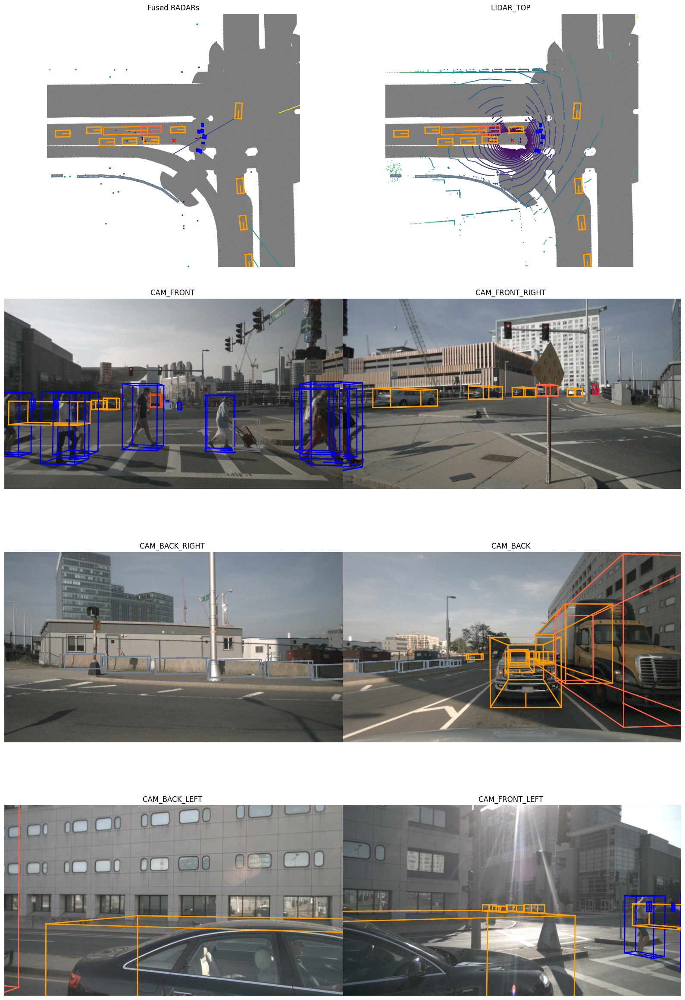

In [ ]:
import random

# pick a random sample token
sample = random.choice(nusc.sample)

# show camera front
nusc.render_sample(sample['token'])


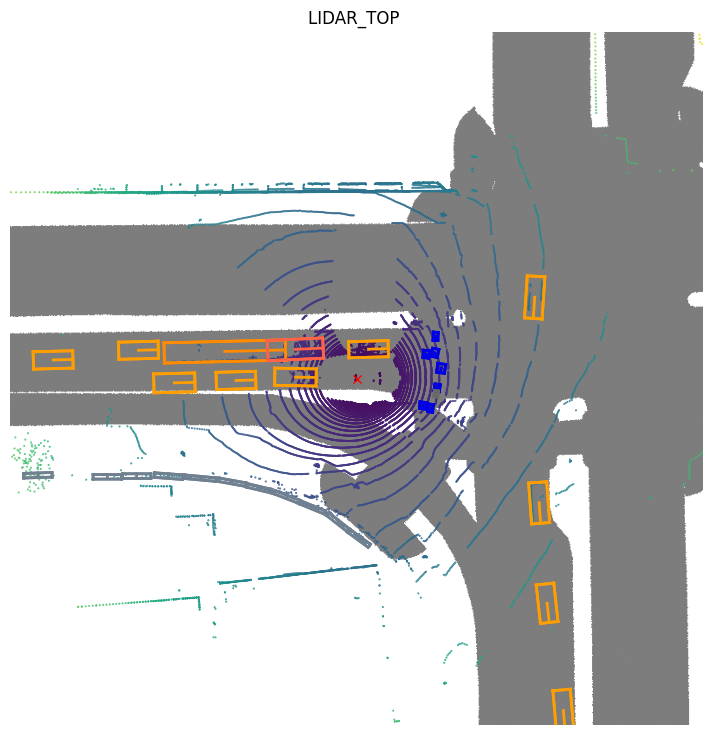

In [ ]:
nusc.render_sample_data(sample['data']['LIDAR_TOP'])


In [ ]:
# Show all scenes (mini has 10 scenes)
for i, scene in enumerate(nusc.scene):
    print(i, scene['name'])


0 scene-0061
1 scene-0103
2 scene-0553
3 scene-0655
4 scene-0757
5 scene-0796
6 scene-0916
7 scene-1077
8 scene-1094
9 scene-1100


In [ ]:
scene = nusc.scene[1]
scene


{'token': 'fcbccedd61424f1b85dcbf8f897f9754',
 'log_token': '53cf9c55dd8644bea67b9f009fc1ee38',
 'nbr_samples': 40,
 'first_sample_token': '3e8750f331d7499e9b5123e9eb70f2e2',
 'last_sample_token': '281b92269fd648d4b52d06ac06ca6d65',
 'name': 'scene-0103',
 'description': 'Many peds right, wait for turning car, long bike rack left, cyclist'}

In [ ]:
first_sample_token = scene['first_sample_token']
sample = nusc.get('sample', first_sample_token)
sample


{'token': '3e8750f331d7499e9b5123e9eb70f2e2',
 'timestamp': 1533151603547590,
 'prev': '',
 'next': '3950bd41f74548429c0f7700ff3d8269',
 'scene_token': 'fcbccedd61424f1b85dcbf8f897f9754',
 'data': {'RADAR_FRONT': '62fc4b9db2f14104ae681bc8afdd5631',
  'RADAR_FRONT_LEFT': '24ba6892937946f28e64a26febe81686',
  'RADAR_FRONT_RIGHT': '17d44aeb803649ac9a3b09ca288e4768',
  'RADAR_BACK_LEFT': 'd7b1dc5d4048477ea89482f0f3ba04d0',
  'RADAR_BACK_RIGHT': '567307635a67407c9ba269ab2777b8e5',
  'LIDAR_TOP': 'fdddd75ee1d94f14a09991988dab8b3e',
  'CAM_FRONT': '4f5e35aa6c6a426ca945e206fb2f4921',
  'CAM_FRONT_RIGHT': '5ed84fb1dbe24efcb00eb766a22d69d6',
  'CAM_BACK_RIGHT': '8fafdaa824b74553b1a08011d29baf20',
  'CAM_BACK': '1908fe7dc09c474ebc6ea23b4c1c5401',
  'CAM_BACK_LEFT': 'e4233736f4ba4fd5989684f0f1e84377',
  'CAM_FRONT_LEFT': '27f02b3e285d4ca18015535511520b3e'},
 'anns': ['c0571ecf3f9a461db18a70f9a6883e4f',
  '7381b60a2a9147518294969bf78412ec',
  'e912747998bb4485b44841c773d6ae7a',
  '404c7efea9604c3da

Showing CAM_FRONT ...


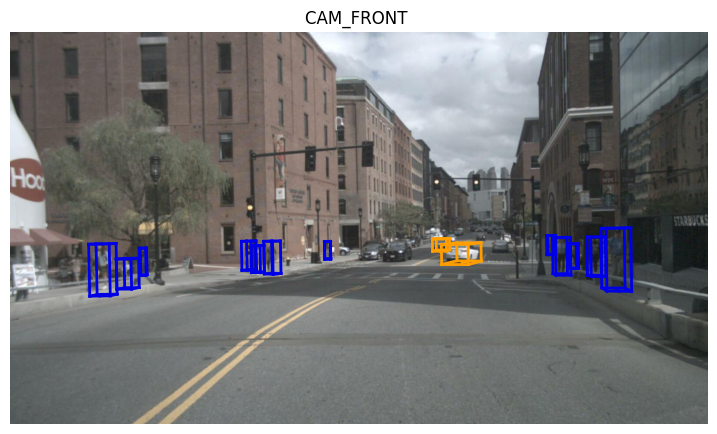

Showing CAM_FRONT_LEFT ...


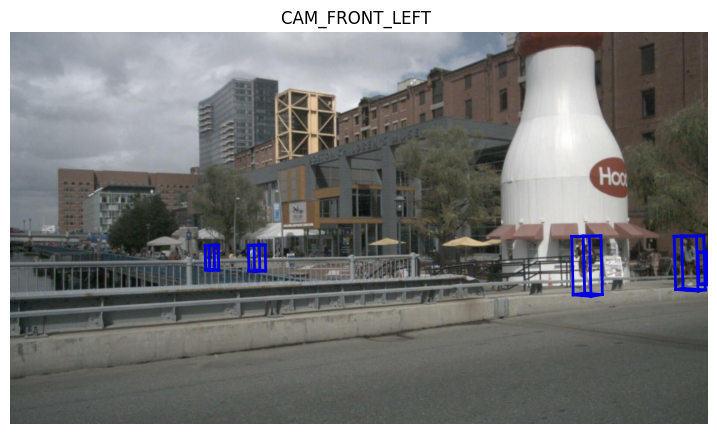

Showing CAM_FRONT_RIGHT ...


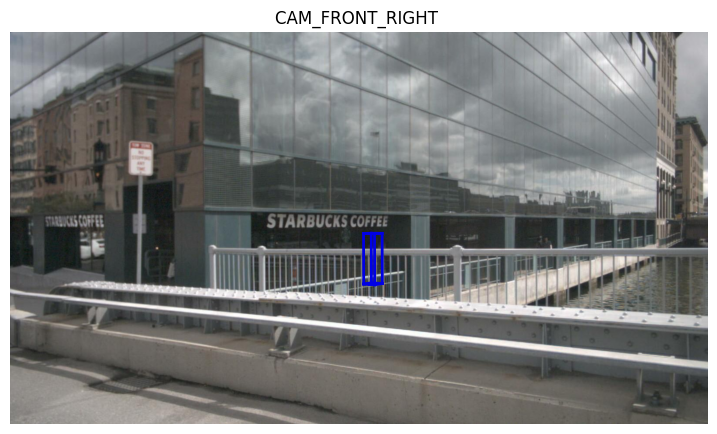

Showing CAM_BACK ...


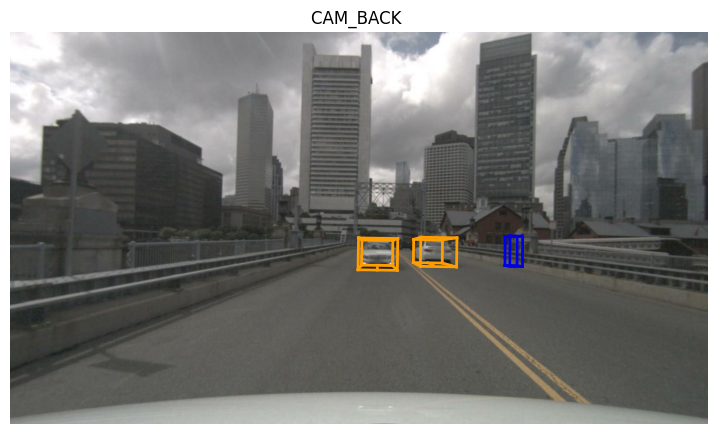

Showing CAM_BACK_LEFT ...


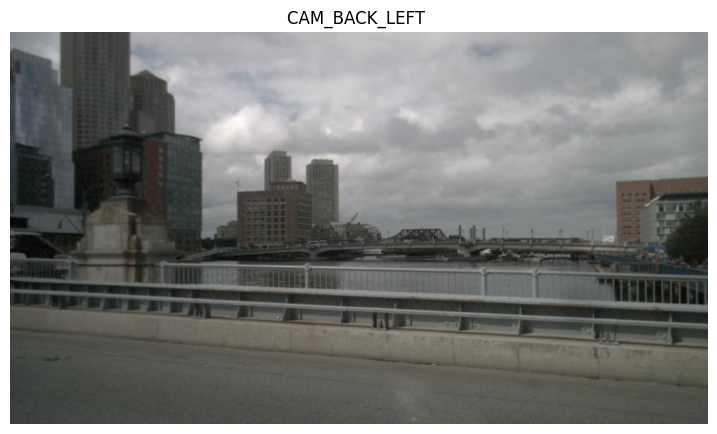

Showing CAM_BACK_RIGHT ...


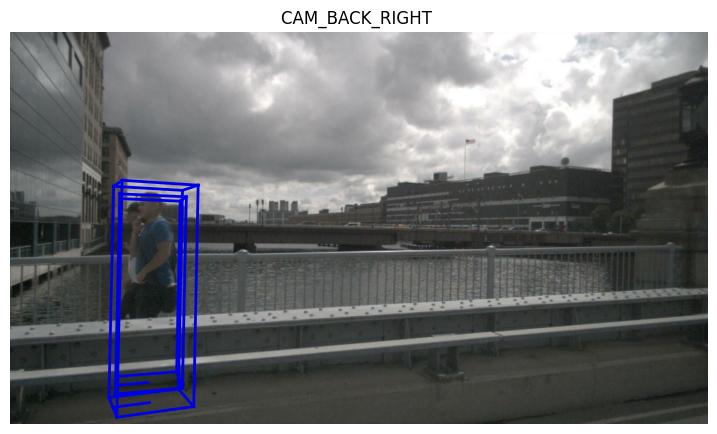

In [ ]:
cameras = ['CAM_FRONT', 'CAM_FRONT_LEFT', 'CAM_FRONT_RIGHT',
           'CAM_BACK', 'CAM_BACK_LEFT', 'CAM_BACK_RIGHT']

for cam in cameras:
    sd_token = sample['data'][cam]
    print(f"Showing {cam} ...")
    nusc.render_sample_data(sd_token)


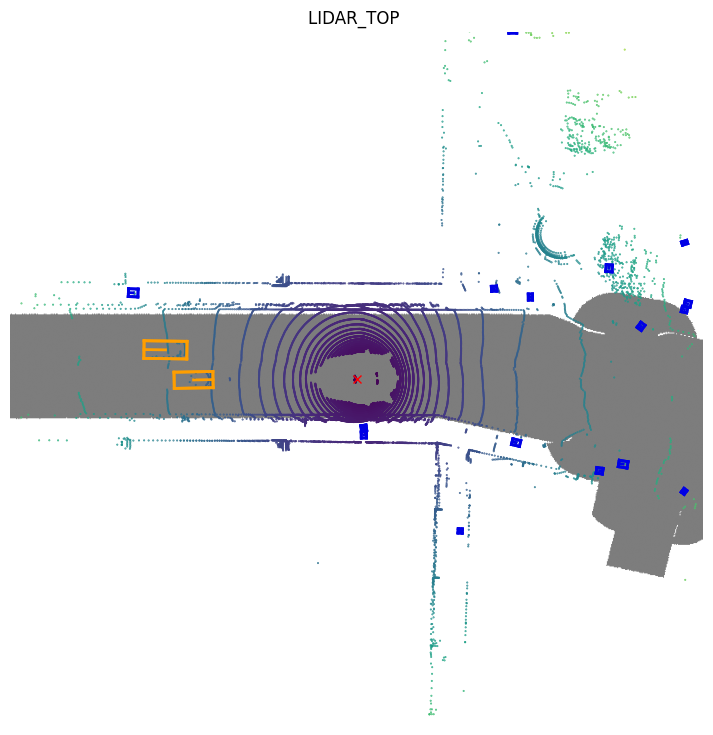

In [ ]:
lidar_token = sample['data']['LIDAR_TOP']
nusc.render_sample_data(lidar_token, nsweeps=1)


In [ ]:
for ann in sample['anns'][:10]:  # print first 10 only
    ann_record = nusc.get('sample_annotation', ann)
    print(ann_record['category_name'], ann_record['translation'])


human.pedestrian.adult [637.141, 1636.252, -0.235]
human.pedestrian.adult [612.719, 1632.142, 0.491]
human.pedestrian.adult [619.03, 1648.941, 0.413]
human.pedestrian.adult [635.378, 1674.253, -0.163]
human.pedestrian.adult [622.35, 1624.018, -0.016]
vehicle.car [635.447, 1620.546, -0.326]
human.pedestrian.adult [598.103, 1642.075, 1.029]
human.pedestrian.adult [622.249, 1646.081, 0.321]
human.pedestrian.adult [619.603, 1624.655, 0.071]
vehicle.car [583.549, 1656.391, 1.267]


In [ ]:
scene = nusc.scene[1]
scene


{'token': 'fcbccedd61424f1b85dcbf8f897f9754',
 'log_token': '53cf9c55dd8644bea67b9f009fc1ee38',
 'nbr_samples': 40,
 'first_sample_token': '3e8750f331d7499e9b5123e9eb70f2e2',
 'last_sample_token': '281b92269fd648d4b52d06ac06ca6d65',
 'name': 'scene-0103',
 'description': 'Many peds right, wait for turning car, long bike rack left, cyclist'}

In [ ]:
first_sample_token = scene['first_sample_token']
sample = nusc.get('sample', first_sample_token)
sample


{'token': '3e8750f331d7499e9b5123e9eb70f2e2',
 'timestamp': 1533151603547590,
 'prev': '',
 'next': '3950bd41f74548429c0f7700ff3d8269',
 'scene_token': 'fcbccedd61424f1b85dcbf8f897f9754',
 'data': {'RADAR_FRONT': '62fc4b9db2f14104ae681bc8afdd5631',
  'RADAR_FRONT_LEFT': '24ba6892937946f28e64a26febe81686',
  'RADAR_FRONT_RIGHT': '17d44aeb803649ac9a3b09ca288e4768',
  'RADAR_BACK_LEFT': 'd7b1dc5d4048477ea89482f0f3ba04d0',
  'RADAR_BACK_RIGHT': '567307635a67407c9ba269ab2777b8e5',
  'LIDAR_TOP': 'fdddd75ee1d94f14a09991988dab8b3e',
  'CAM_FRONT': '4f5e35aa6c6a426ca945e206fb2f4921',
  'CAM_FRONT_RIGHT': '5ed84fb1dbe24efcb00eb766a22d69d6',
  'CAM_BACK_RIGHT': '8fafdaa824b74553b1a08011d29baf20',
  'CAM_BACK': '1908fe7dc09c474ebc6ea23b4c1c5401',
  'CAM_BACK_LEFT': 'e4233736f4ba4fd5989684f0f1e84377',
  'CAM_FRONT_LEFT': '27f02b3e285d4ca18015535511520b3e'},
 'anns': ['c0571ecf3f9a461db18a70f9a6883e4f',
  '7381b60a2a9147518294969bf78412ec',
  'e912747998bb4485b44841c773d6ae7a',
  '404c7efea9604c3da

Showing CAM_FRONT ...


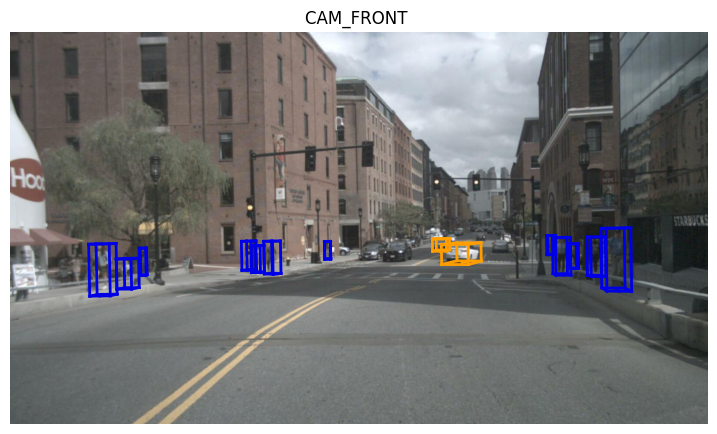

Showing CAM_FRONT_LEFT ...


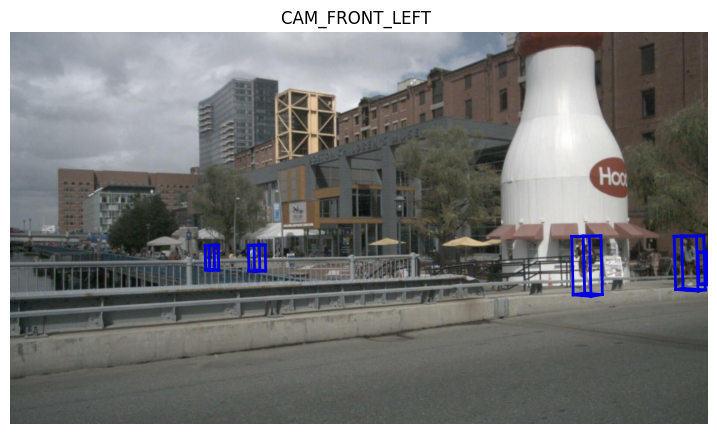

Showing CAM_FRONT_RIGHT ...


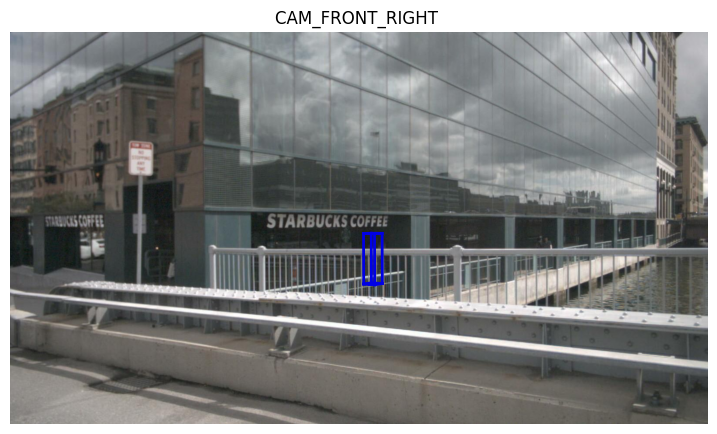

Showing CAM_BACK ...


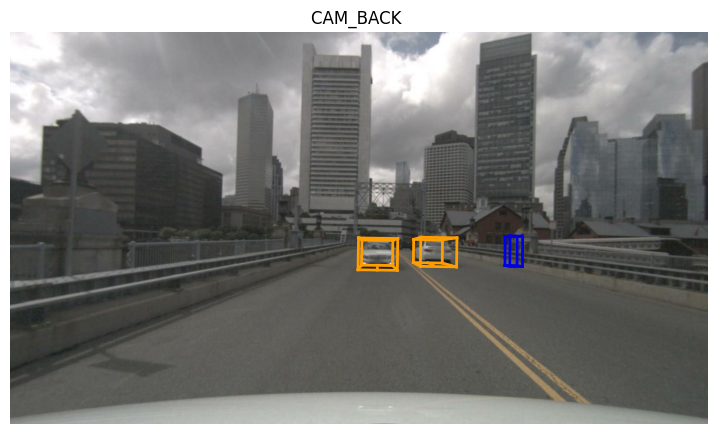

Showing CAM_BACK_LEFT ...


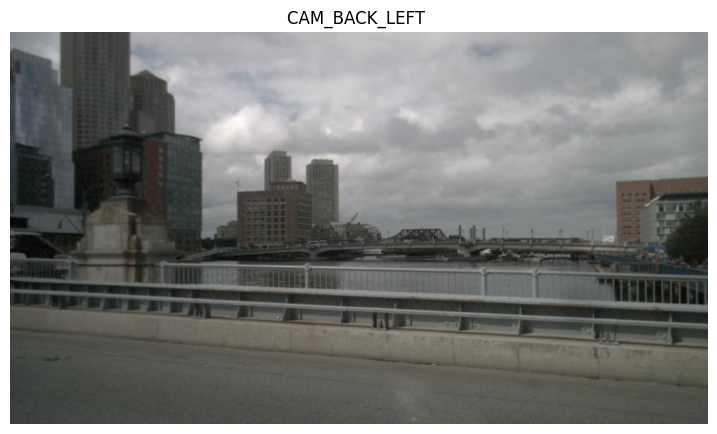

Showing CAM_BACK_RIGHT ...


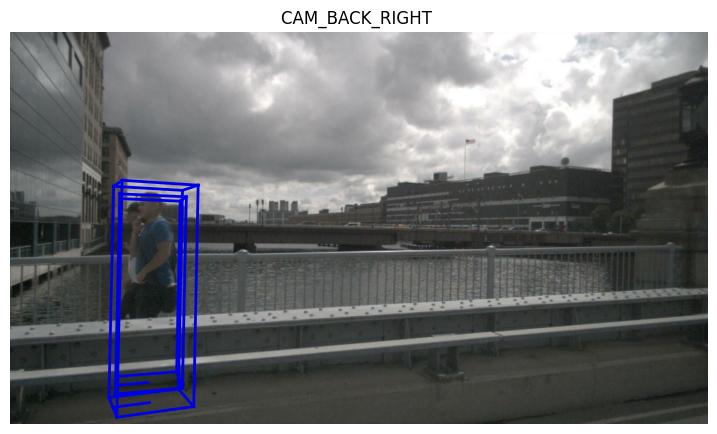

In [ ]:
cameras = ['CAM_FRONT', 'CAM_FRONT_LEFT', 'CAM_FRONT_RIGHT',
           'CAM_BACK', 'CAM_BACK_LEFT', 'CAM_BACK_RIGHT']

for cam in cameras:
    sd_token = sample['data'][cam]
    print(f"Showing {cam} ...")
    nusc.render_sample_data(sd_token)


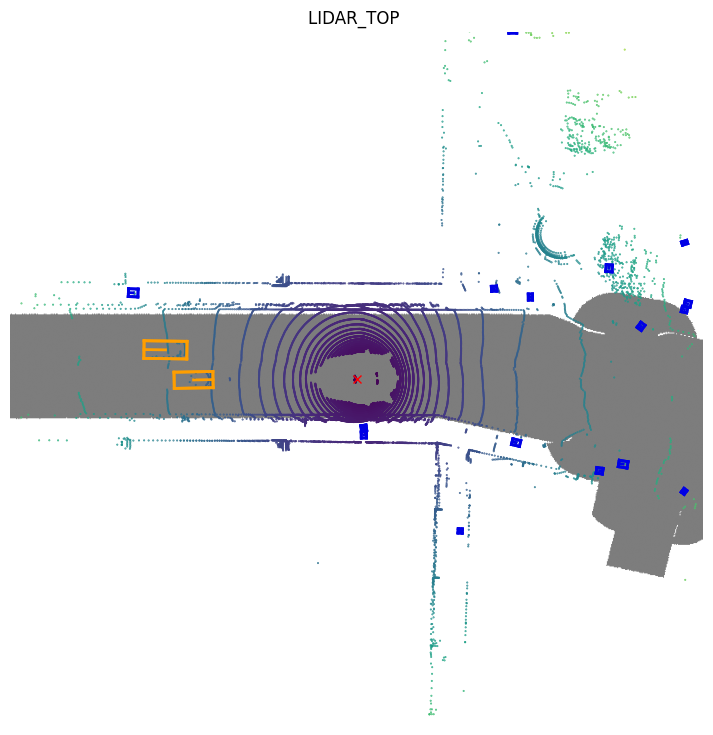

In [ ]:
lidar_token = sample['data']['LIDAR_TOP']
nusc.render_sample_data(lidar_token, nsweeps=1)


In [ ]:
for ann in sample['anns'][:10]:
    ann_record = nusc.get('sample_annotation', ann)
    print(ann_record['category_name'], ann_record['translation'])


human.pedestrian.adult [637.141, 1636.252, -0.235]
human.pedestrian.adult [612.719, 1632.142, 0.491]
human.pedestrian.adult [619.03, 1648.941, 0.413]
human.pedestrian.adult [635.378, 1674.253, -0.163]
human.pedestrian.adult [622.35, 1624.018, -0.016]
vehicle.car [635.447, 1620.546, -0.326]
human.pedestrian.adult [598.103, 1642.075, 1.029]
human.pedestrian.adult [622.249, 1646.081, 0.321]
human.pedestrian.adult [619.603, 1624.655, 0.071]
vehicle.car [583.549, 1656.391, 1.267]


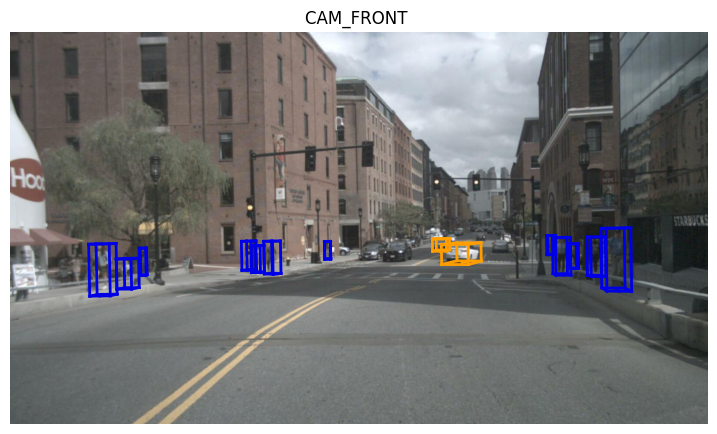

In [ ]:
nusc.render_sample_data(sample['data']['CAM_FRONT'], with_anns=True)


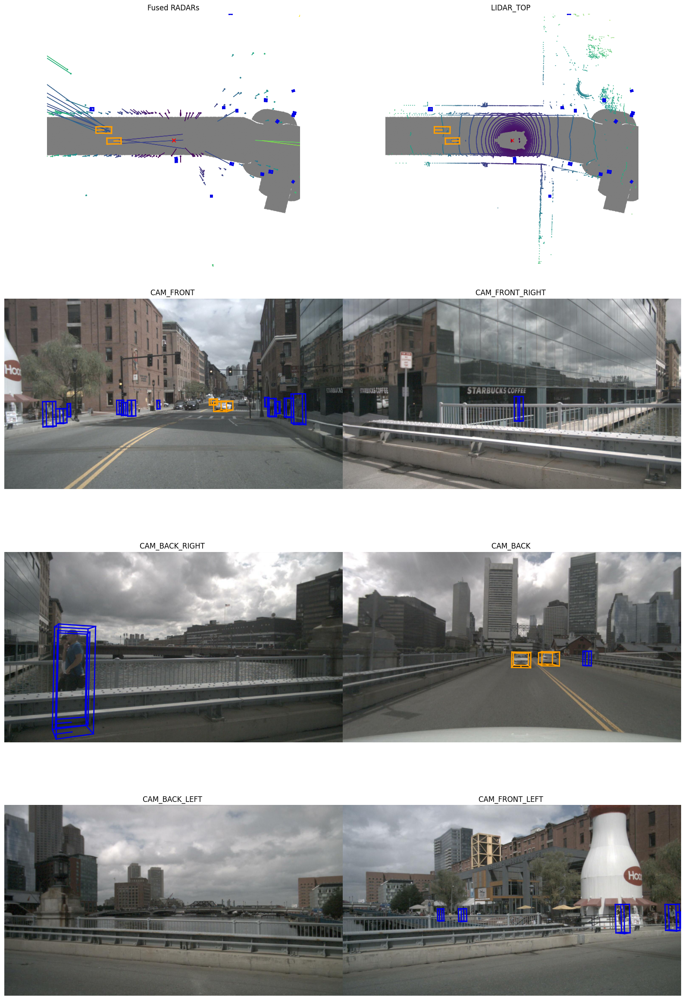

In [ ]:
nusc.render_sample(sample['token'])


In [ ]:
ann_token = sample['anns'][0]
ann = nusc.get('sample_annotation', ann_token)
ann


{'token': 'c0571ecf3f9a461db18a70f9a6883e4f',
 'sample_token': '3e8750f331d7499e9b5123e9eb70f2e2',
 'instance_token': 'ab8d210d019b44abae3c4e0eee6ce8ba',
 'visibility_token': '1',
 'attribute_tokens': ['ab83627ff28b465b85c427162dec722f'],
 'translation': [637.141, 1636.252, -0.235],
 'size': [0.621, 0.647, 1.778],
 'rotation': [0.3495370229501108, 0.0, 0.0, 0.9369225526088982],
 'prev': '',
 'next': 'd08b8c6ecc6b4824aa890ffac8a288a8',
 'num_lidar_pts': 1,
 'num_radar_pts': 0,
 'category_name': 'human.pedestrian.adult'}

In [ ]:
from pyquaternion import Quaternion
from nuscenes.utils.data_classes import Box

quat = Quaternion(ann['rotation'])   # convert list → Quaternion

box = Box(center=ann['translation'],
          size=ann['size'],
          orientation=quat)

box.corners()


array([[ 6.36693177e+02,  6.37099919e+02,  6.37099919e+02,
         6.36693177e+02,  6.37182081e+02,  6.37588823e+02,
         6.37588823e+02,  6.37182081e+02],
       [ 1.63622926e+03,  1.63669851e+03,  1.63669851e+03,
         1.63622926e+03,  1.63580549e+03,  1.63627474e+03,
         1.63627474e+03,  1.63580549e+03],
       [ 6.54000000e-01,  6.54000000e-01, -1.12400000e+00,
        -1.12400000e+00,  6.54000000e-01,  6.54000000e-01,
        -1.12400000e+00, -1.12400000e+00]])

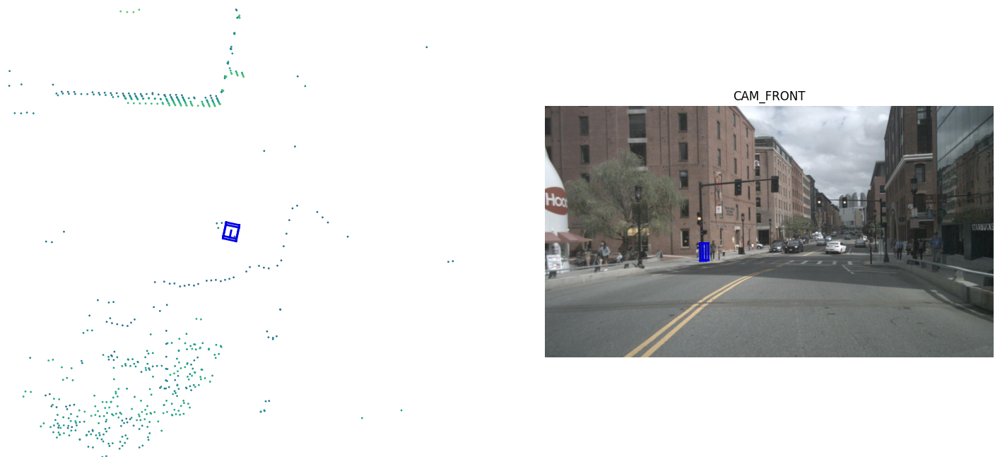

In [ ]:
nusc.render_annotation(ann_token)


In [ ]:
from nuscenes.utils.data_classes import Box
from nuscenes.utils.geometry_utils import view_points
import matplotlib.pyplot as plt
import numpy as np




In [ ]:
from pyquaternion import Quaternion

# Convert rotation
quat = Quaternion(ann['rotation'])

# Build 3D Box correctly
box = Box(center=ann['translation'],
          size=ann['size'],
          orientation=quat)


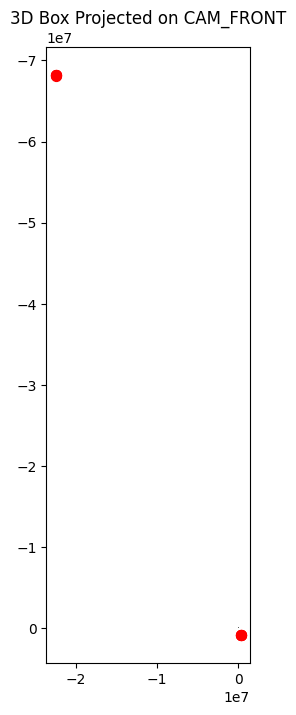

In [ ]:
from pyquaternion import Quaternion
import matplotlib.pyplot as plt
import numpy as np

# Get sample
sample = nusc.sample[0]

# Camera front
cam_token = sample['data']['CAM_FRONT']
cam_data = nusc.get('sample_data', cam_token)

# Image path
image_path = nusc.get_sample_data_path(cam_token)
img = plt.imread(image_path)

# Annotation
ann_token = sample['anns'][0]
ann = nusc.get('sample_annotation', ann_token)

# FIX: Convert rotation list → Quaternion
quat = Quaternion(ann['rotation'])

# Build Box
box = Box(center=ann['translation'],
          size=ann['size'],
          orientation=quat)

# Calibrated sensor (camera intrinsics)
cs = nusc.get('calibrated_sensor', cam_data['calibrated_sensor_token'])
camera_intrinsic = np.array(cs['camera_intrinsic'])

# 3D → 2D
corners_3d = box.corners()
corners_2d = view_points(corners_3d, camera_intrinsic, normalize=True)

# Plot
plt.figure(figsize=(10,8))
plt.imshow(img)
plt.scatter(corners_2d[0], corners_2d[1], c='red', s=50)
plt.title("3D Box Projected on CAM_FRONT")
plt.show()


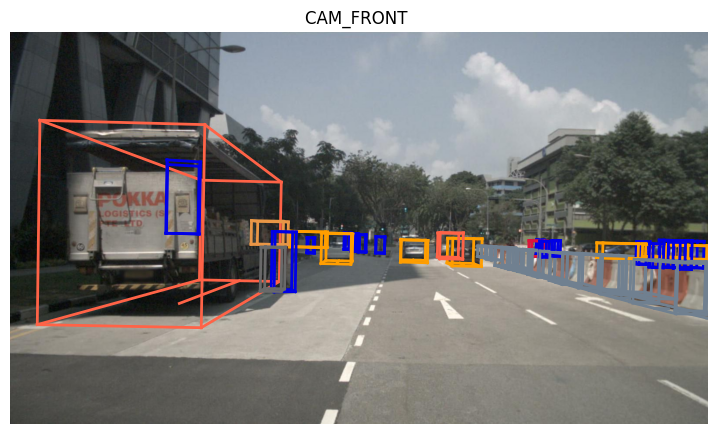

In [ ]:
nusc.render_sample_data(cam_token, with_anns=True, verbose=True)


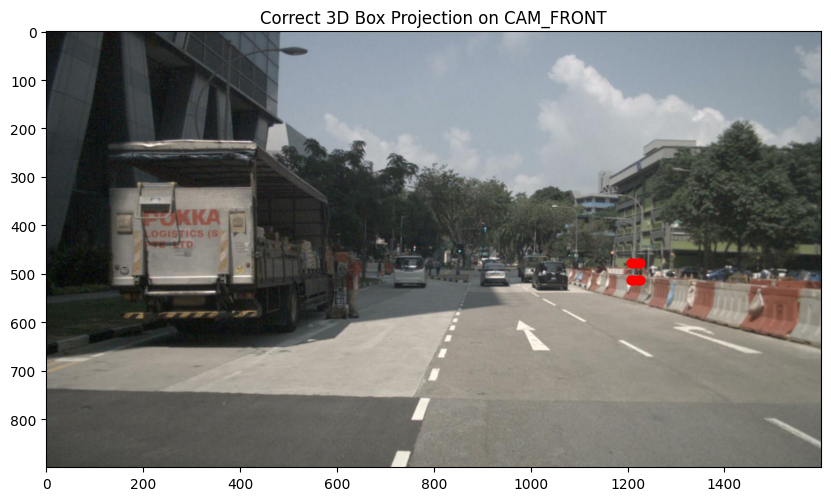

In [ ]:
from pyquaternion import Quaternion
import numpy as np
import matplotlib.pyplot as plt
from nuscenes.utils.geometry_utils import transform_matrix, view_points
from nuscenes.utils.data_classes import Box

# 1. Get camera sample
cam_token = sample['data']['CAM_FRONT']
cam_data = nusc.get('sample_data', cam_token)

# 2. Load image
img = plt.imread(nusc.get_sample_data_path(cam_token))

# 3. Get annotation
ann_token = sample['anns'][0]
ann = nusc.get('sample_annotation', ann_token)

# 4. Build box in GLOBAL coordinates
box = Box(center=ann['translation'],
          size=ann['size'],
          orientation=Quaternion(ann['rotation']))

# 5. Camera transforms
cs = nusc.get('calibrated_sensor', cam_data['calibrated_sensor_token'])
ego = nusc.get('ego_pose', cam_data['ego_pose_token'])

# Global → Ego
box.translate(-np.array(ego['translation']))
box.rotate(Quaternion(ego['rotation']).inverse)

# Ego → Camera
box.translate(-np.array(cs['translation']))
box.rotate(Quaternion(cs['rotation']).inverse)

# 6. Project to image plane
corners_3d = box.corners()
corners_2d = view_points(corners_3d, np.array(cs['camera_intrinsic']), normalize=True)

# 7. Plot image + points
plt.figure(figsize=(10,8))
plt.imshow(img)
plt.scatter(corners_2d[0], corners_2d[1], c='red', s=40)
plt.title("Correct 3D Box Projection on CAM_FRONT")
plt.show()


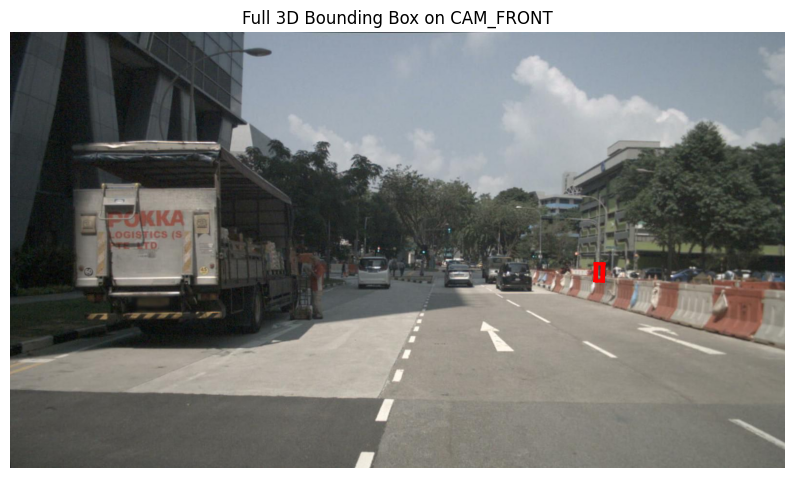

In [ ]:
from pyquaternion import Quaternion
import numpy as np
import matplotlib.pyplot as plt
from nuscenes.utils.geometry_utils import view_points
from nuscenes.utils.data_classes import Box

# 1️⃣ Get camera sample token
cam_token = sample['data']['CAM_FRONT']
cam_data = nusc.get('sample_data', cam_token)

# 2️⃣ Load image
img_path = nusc.get_sample_data_path(cam_token)
img = plt.imread(img_path)

# 3️⃣ Choose an annotation (1st box)
ann_token = sample['anns'][0]
ann = nusc.get('sample_annotation', ann_token)

# 4️⃣ Create box in GLOBAL coords
box = Box(center=ann['translation'],
          size=ann['size'],
          orientation=Quaternion(ann['rotation']))

# 5️⃣ Camera transforms
cs = nusc.get('calibrated_sensor', cam_data['calibrated_sensor_token'])
ego = nusc.get('ego_pose', cam_data['ego_pose_token'])

# GLOBAL → EGO
box.translate(-np.array(ego['translation']))
box.rotate(Quaternion(ego['rotation']).inverse)

# EGO → CAMERA
box.translate(-np.array(cs['translation']))
box.rotate(Quaternion(cs['rotation']).inverse)

# 6️⃣ Project 3D corners to 2D image
corners_3d = box.corners()
corners_2d = view_points(
    corners_3d,
    np.array(cs['camera_intrinsic']),
    normalize=True
)

# 7️⃣ Plot image + the 3D box
plt.figure(figsize=(10, 8))
plt.imshow(img)

# Draw lines between corners
edges = [
    [0,1], [1,2], [2,3], [3,0],   # bottom rectangle
    [4,5], [5,6], [6,7], [7,4],   # top rectangle
    [0,4], [1,5], [2,6], [3,7]    # vertical edges
]

for e1, e2 in edges:
    x = [corners_2d[0, e1], corners_2d[0, e2]]
    y = [corners_2d[1, e1], corners_2d[1, e2]]
    plt.plot(x, y, 'r-', linewidth=2)

plt.title("Full 3D Bounding Box on CAM_FRONT")
plt.axis("off")
plt.show()


In [ ]:
# Choose a scene
scene = nusc.scene[0]   # scene-0001

# Get all sample tokens (each sample is a moment in time)
sample_tokens = []
current = scene['first_sample_token']

while current != "":
    sample_tokens.append(current)
    current = nusc.get('sample', current)['next']

len(sample_tokens)


39

In [ ]:
ego_positions = []
ego_timestamps = []

for token in sample_tokens:
    sample = nusc.get('sample', token)
    sd = nusc.get('sample_data', sample['data']['LIDAR_TOP'])
    ego_pose = nusc.get('ego_pose', sd['ego_pose_token'])

    ego_positions.append(np.array(ego_pose['translation']))
    ego_timestamps.append(sd['timestamp'])   # in microseconds



In [ ]:
ego_speeds = [0]   # first frame speed = 0

for i in range(1, len(ego_positions)):
    p_prev = ego_positions[i-1]
    p_curr = ego_positions[i]

    # distance moved between frames
    dist = np.linalg.norm(p_curr - p_prev)  # in meters

    # time difference
    dt = (ego_timestamps[i] - ego_timestamps[i-1]) / 1e6  # convert µs to seconds

    speed = dist / dt  # m/s
    ego_speeds.append(speed)


In [ ]:
ego_speeds[:10]


[0,
 8.988266307839098,
 8.749225025834907,
 8.358815374595311,
 8.143925910154083,
 7.679286808931519,
 7.50137428236383,
 7.252256524053056,
 6.965985825658533,
 6.764057032501625]

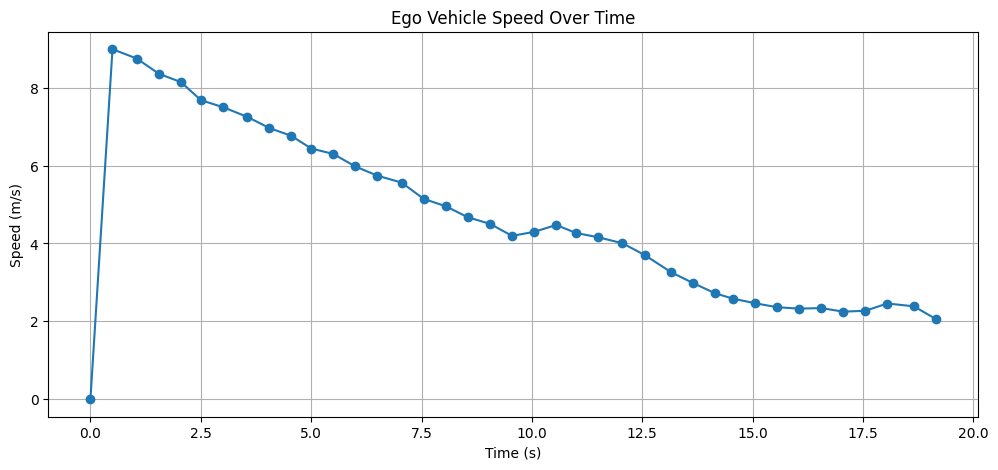

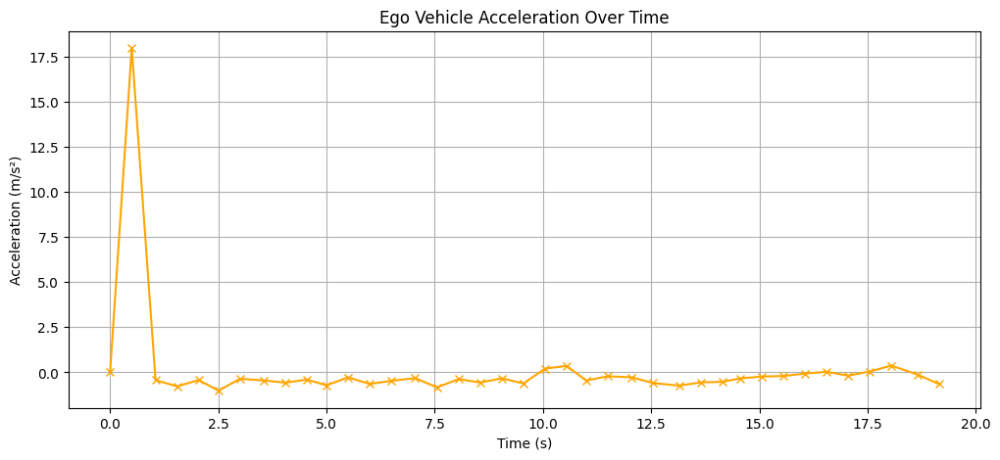

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# --- 1. EXTRACT EGO POSITIONS + TIMESTAMPS ---
ego_positions = []
ego_timestamps = []

for token in sample_tokens:
    sample = nusc.get('sample', token)
    sd = nusc.get('sample_data', sample['data']['LIDAR_TOP'])
    pose = nusc.get('ego_pose', sd['ego_pose_token'])

    ego_positions.append(np.array(pose['translation']))
    ego_timestamps.append(sd['timestamp'])   # microseconds


# --- 2. COMPUTE EGO SPEED (m/s) ---
ego_speeds = [0]  # first frame speed = 0

for i in range(1, len(ego_positions)):
    p_prev = ego_positions[i-1]
    p_curr = ego_positions[i]

    dist = np.linalg.norm(p_curr - p_prev)
    dt = (ego_timestamps[i] - ego_timestamps[i-1]) / 1e6  # seconds

    speed = dist / dt
    ego_speeds.append(speed)


# --- 3. COMPUTE EGO ACCELERATION (m/s²) ---
ego_accels = [0]  # first frame accel = 0

for i in range(1, len(ego_speeds)):
    dv = ego_speeds[i] - ego_speeds[i-1]
    dt = (ego_timestamps[i] - ego_timestamps[i-1]) / 1e6

    accel = dv / dt
    ego_accels.append(accel)


# --- 4. CREATE RELATIVE TIME ARRAY ---
relative_time = (np.array(ego_timestamps) - ego_timestamps[0]) / 1e6


# --- 5. PLOT SPEED ---
plt.figure(figsize=(12,5))
plt.plot(relative_time, ego_speeds, marker='o')
plt.xlabel("Time (s)")
plt.ylabel("Speed (m/s)")
plt.title("Ego Vehicle Speed Over Time")
plt.grid(True)
plt.show()

# --- 6. PLOT ACCELERATION ---
plt.figure(figsize=(12,5))
plt.plot(relative_time, ego_accels, marker='x', color='orange')
plt.xlabel("Time (s)")
plt.ylabel("Acceleration (m/s²)")
plt.title("Ego Vehicle Acceleration Over Time")
plt.grid(True)
plt.show()


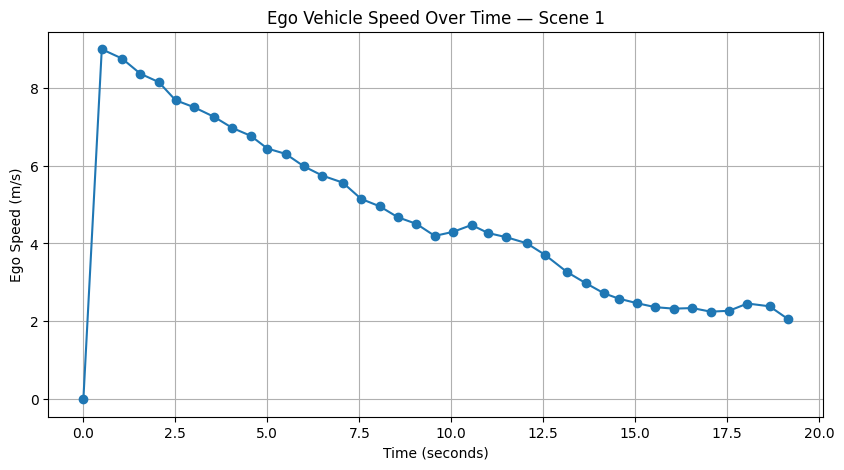

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Convert timestamps to seconds relative to first frame
relative_time = (np.array(ego_timestamps) - ego_timestamps[0]) / 1e6

plt.figure(figsize=(10,5))
plt.plot(relative_time, ego_speeds, marker='o')
plt.xlabel("Time (seconds)")
plt.ylabel("Ego Speed (m/s)")
plt.title("Ego Vehicle Speed Over Time — Scene 1")
plt.grid(True)
plt.show()


In [ ]:
dist_car = []
dist_ped = []
dist_min = []

for token in sample_tokens:
    sample = nusc.get('sample', token)

    # Ego position (using LiDAR_TOP reference)
    sd = nusc.get('sample_data', sample['data']['LIDAR_TOP'])
    ego_pose = nusc.get('ego_pose', sd['ego_pose_token'])
    ego_pos = np.array(ego_pose['translation'])

    nearest_car = float('inf')
    nearest_ped = float('inf')

    for ann_token in sample['anns']:
        ann = nusc.get('sample_annotation', ann_token)
        category = ann['category_name']
        obj_pos = np.array(ann['translation'])

        dist = np.linalg.norm(obj_pos - ego_pos)

        # Cars
        if "vehicle." in category:
            nearest_car = min(nearest_car, dist)

        # Pedestrians
        if "human.pedestrian" in category:
            nearest_ped = min(nearest_ped, dist)

    dist_car.append(nearest_car)
    dist_ped.append(nearest_ped)
    dist_min.append(min(nearest_car, nearest_ped))


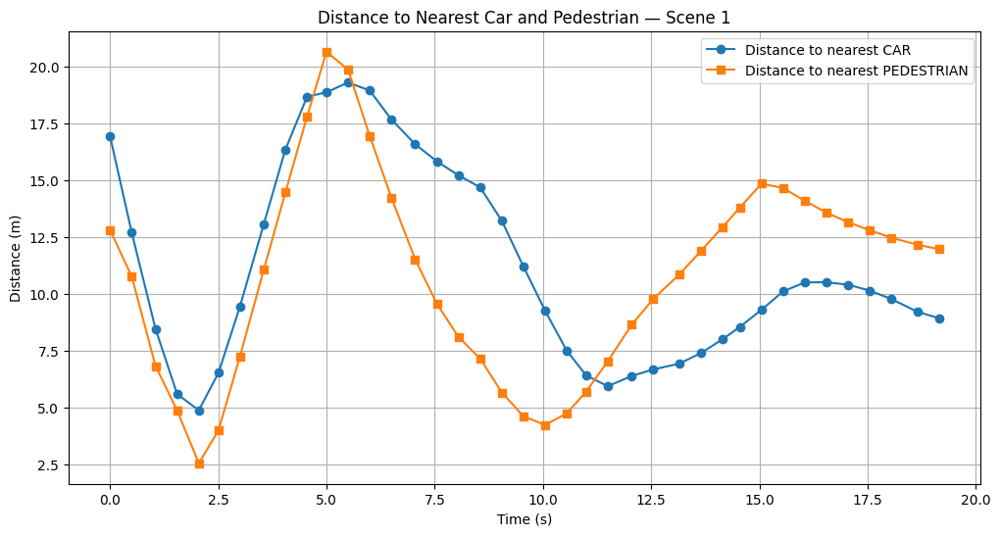

In [ ]:
plt.figure(figsize=(12,6))
plt.plot(relative_time, dist_car, marker='o', label='Distance to nearest CAR')
plt.plot(relative_time, dist_ped, marker='s', label='Distance to nearest PEDESTRIAN')
plt.xlabel("Time (s)")
plt.ylabel("Distance (m)")
plt.title("Distance to Nearest Car and Pedestrian — Scene 1")
plt.legend()
plt.grid(True)
plt.show()


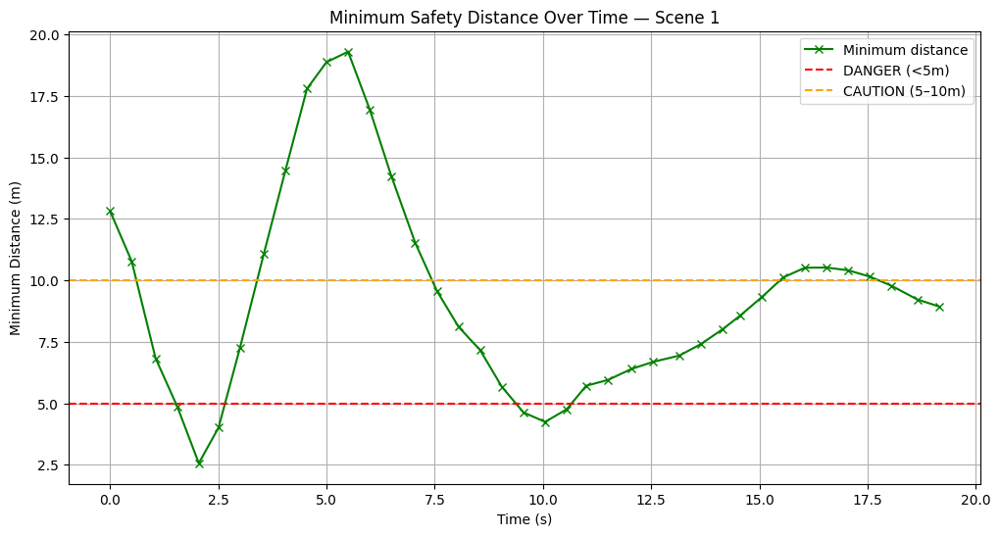

In [ ]:
plt.figure(figsize=(12,6))
plt.plot(relative_time, dist_min, marker='x', color='green', label='Minimum distance')

plt.axhline(5, color='red', linestyle='--', label='DANGER (<5m)')
plt.axhline(10, color='orange', linestyle='--', label='CAUTION (5–10m)')

plt.xlabel("Time (s)")
plt.ylabel("Minimum Distance (m)")
plt.title("Minimum Safety Distance Over Time — Scene 1")
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
# For storing TTC values
ttc_values = []

# Loop through frames (except last)
for i in range(len(sample_tokens)-1):

    # current + next sample
    curr_token = sample_tokens[i]
    next_token = sample_tokens[i+1]

    curr_sample = nusc.get('sample', curr_token)
    next_sample = nusc.get('sample', next_token)

    # Ego position
    sd_curr = nusc.get('sample_data', curr_sample['data']['LIDAR_TOP'])
    sd_next = nusc.get('sample_data', next_sample['data']['LIDAR_TOP'])

    ego_curr = np.array(nusc.get('ego_pose', sd_curr['ego_pose_token'])['translation'])
    ego_next = np.array(nusc.get('ego_pose', sd_next['ego_pose_token'])['translation'])

    dt = (sd_next['timestamp'] - sd_curr['timestamp']) / 1e6  # seconds

    # Ego speed
    ego_speed = np.linalg.norm(ego_next - ego_curr) / dt

    # Find nearest object (car or pedestrian)
    min_dist = float('inf')
    closest_ann_curr = None

    for ann_token in curr_sample['anns']:
        ann = nusc.get('sample_annotation', ann_token)
        category = ann['category_name']

        if "vehicle." in category or "human.pedestrian" in category:
            dist = np.linalg.norm(np.array(ann['translation']) - ego_curr)
            if dist < min_dist:
                min_dist = dist
                closest_ann_curr = ann_token

    # No objects in scene
    if closest_ann_curr is None:
        ttc_values.append(np.inf)
        continue

    # object current and next positions
    ann_curr = nusc.get('sample_annotation', closest_ann_curr)

    # match same instance in next frame
    ann_next_token = None
    for ann_token_nxt in next_sample['anns']:
        ann_next = nusc.get('sample_annotation', ann_token_nxt)
        if ann_next['instance_token'] == ann_curr['instance_token']:
            ann_next_token = ann_token_nxt
            break

    if ann_next_token is None:
        ttc_values.append(np.inf)
        continue

    ann_next = nusc.get('sample_annotation', ann_next_token)

    obj_curr = np.array(ann_curr['translation'])
    obj_next = np.array(ann_next['translation'])

    obj_speed = np.linalg.norm(obj_next - obj_curr) / dt

    # relative speed (ego → object)
    relative_speed = ego_speed - obj_speed

    # TTC
    if relative_speed > 0:   # closing in
        ttc = min_dist / relative_speed
    else:
        ttc = np.inf          # object moving away

    ttc_values.append(ttc)


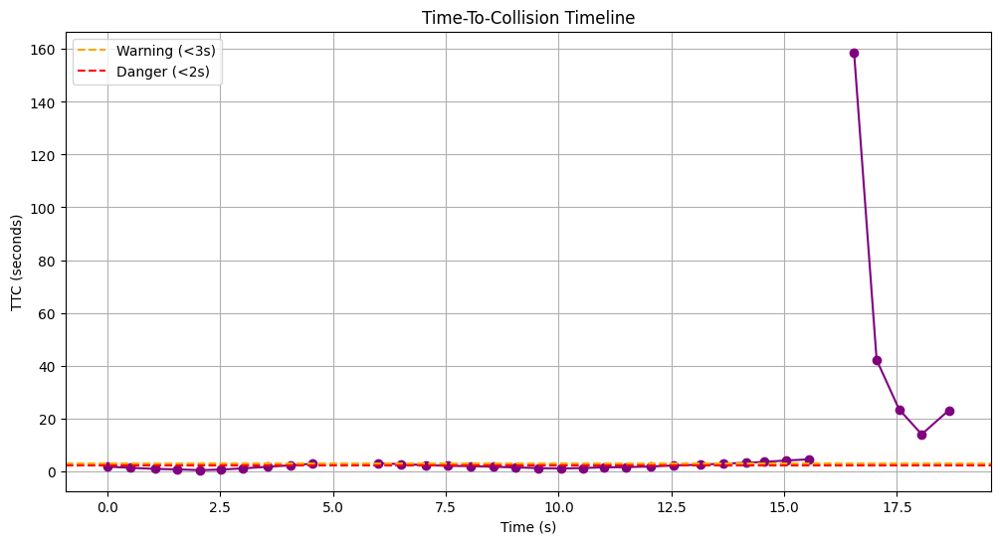

In [ ]:
plt.figure(figsize=(12,6))
plt.plot(relative_time[:-1], ttc_values, marker='o', color='purple')
plt.axhline(3, color='orange', linestyle='--', label='Warning (<3s)')
plt.axhline(2, color='red', linestyle='--', label='Danger (<2s)')
plt.xlabel("Time (s)")
plt.ylabel("TTC (seconds)")
plt.title("Time-To-Collision Timeline")
plt.legend()
plt.grid(True)
plt.show()


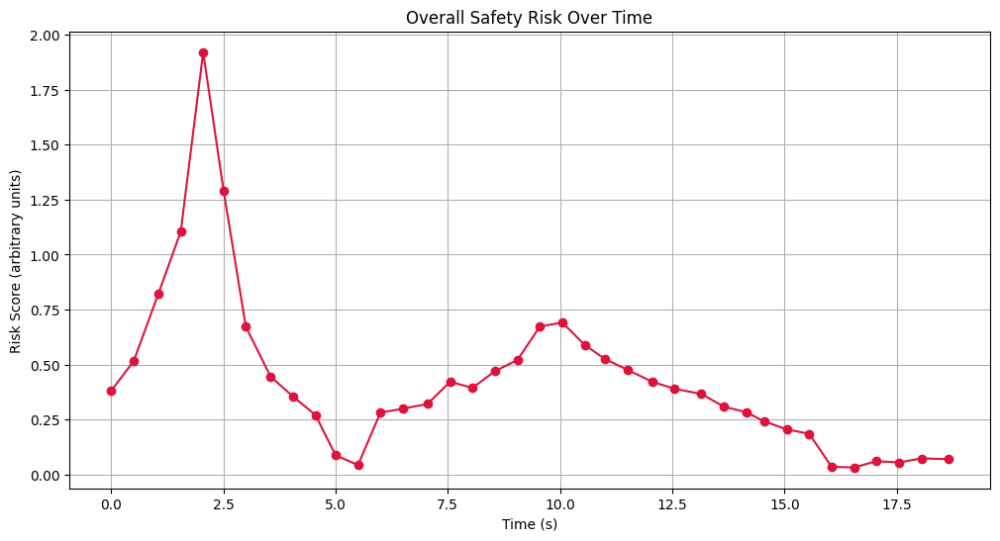

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# 1️⃣ Convert lists to numpy arrays
dist_min_arr = np.array(dist_min)
ego_accels_arr = np.array(ego_accels)
ttc_arr = np.array(ttc_values)

# 2️⃣ Make all arrays same length
n = min(len(dist_min_arr), len(ego_accels_arr), len(ttc_arr))
dist_min_arr = dist_min_arr[:n]
ego_accels_arr = ego_accels_arr[:n]
ttc_arr = ttc_arr[:n]
time_arr = relative_time[:n]

# 3️⃣ Define weights (NOW w1, w2, w3 ARE DEFINED ✅)
w1 = 0.6   # TTC weight
w2 = 0.3   # Distance weight
w3 = 0.1   # Acceleration weight

# 4️⃣ Avoid division by zero / infinity in TTC & distance
safe_ttc = np.copy(ttc_arr)
safe_ttc[~np.isfinite(safe_ttc)] = 9999  # if inf, treat as very safe

safe_dist = np.copy(dist_min_arr)
safe_dist[safe_dist <= 0] = 0.1  # avoid divide by zero

# 5️⃣ Compute simple risk score
risk_scores = (
    w1 * (1.0 / safe_ttc) +      # higher when TTC small
    w2 * (1.0 / safe_dist) +     # higher when distance small
    w3 * np.maximum(0, -ego_accels_arr)  # braking → positive risk
)

# 6️⃣ Plot risk over time
plt.figure(figsize=(12,6))
plt.plot(time_arr, risk_scores, marker='o', color='crimson')
plt.xlabel("Time (s)")
plt.ylabel("Risk Score (arbitrary units)")
plt.title("Overall Safety Risk Over Time")
plt.grid(True)
plt.show()


In [ ]:
# Make sure arrays align with risk_scores length
n = len(risk_scores)
time_used = time_arr[:n]
dist_used = dist_min_arr[:n]
ttc_used = ttc_arr[:n]

# If you have ego_speeds defined:
ego_speeds_used = np.array(ego_speeds[:n])

# Get indices sorted by risk (highest first)
top_idx = np.argsort(-risk_scores)  # minus sign = descending

top_k = 3  # top 3 dangerous frames

print("Top dangerous frames in this scene:\n")
for rank in range(top_k):
    i = int(top_idx[rank])
    print(f"Rank {rank+1}:")
    print(f"  Time          : {time_used[i]:.2f} s")
    print(f"  Risk score    : {risk_scores[i]:.3f}")
    print(f"  Min distance  : {dist_used[i]:.2f} m")
    print(f"  TTC           : {ttc_used[i]:.2f} s")
    print(f"  Ego speed     : {ego_speeds_used[i]:.2f} m/s")
    print("-"*40)


Top dangerous frames in this scene:

Rank 1:
  Time          : 2.05 s
  Risk score    : 1.920
  Min distance  : 2.56 m
  TTC           : 0.34 s
  Ego speed     : 8.14 m/s
----------------------------------------
Rank 2:
  Time          : 2.50 s
  Risk score    : 1.290
  Min distance  : 4.01 m
  TTC           : 0.54 s
  Ego speed     : 7.68 m/s
----------------------------------------
Rank 3:
  Time          : 1.55 s
  Risk score    : 1.105
  Min distance  : 4.87 m
  TTC           : 0.62 s
  Ego speed     : 8.36 m/s
----------------------------------------



=== Visualizing dangerous frame Rank 1 (t = 2.05 s) ===


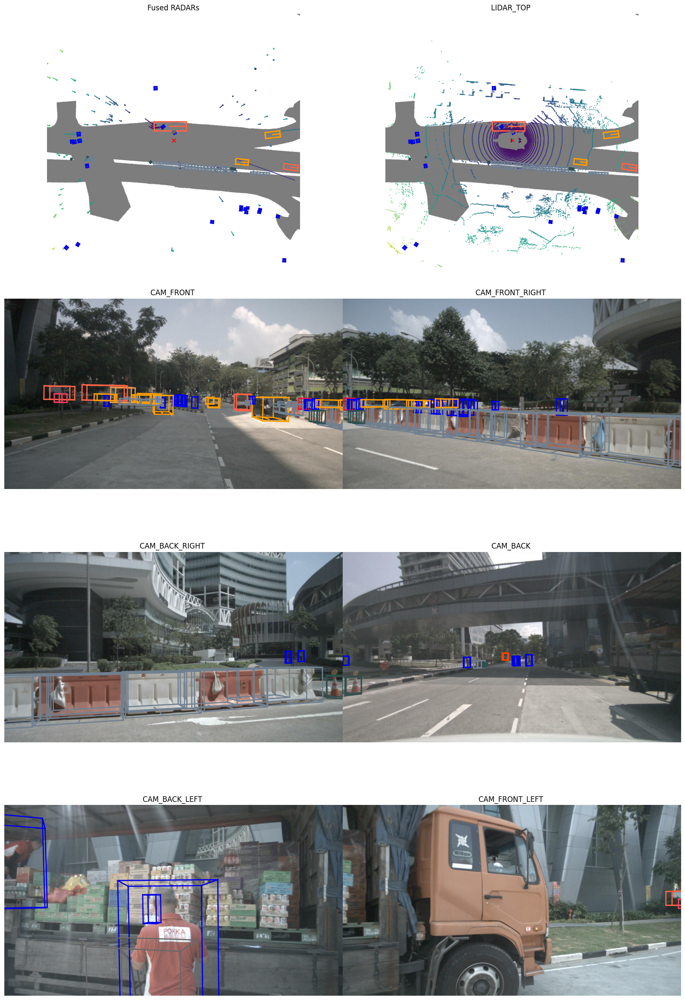


=== Visualizing dangerous frame Rank 2 (t = 2.50 s) ===


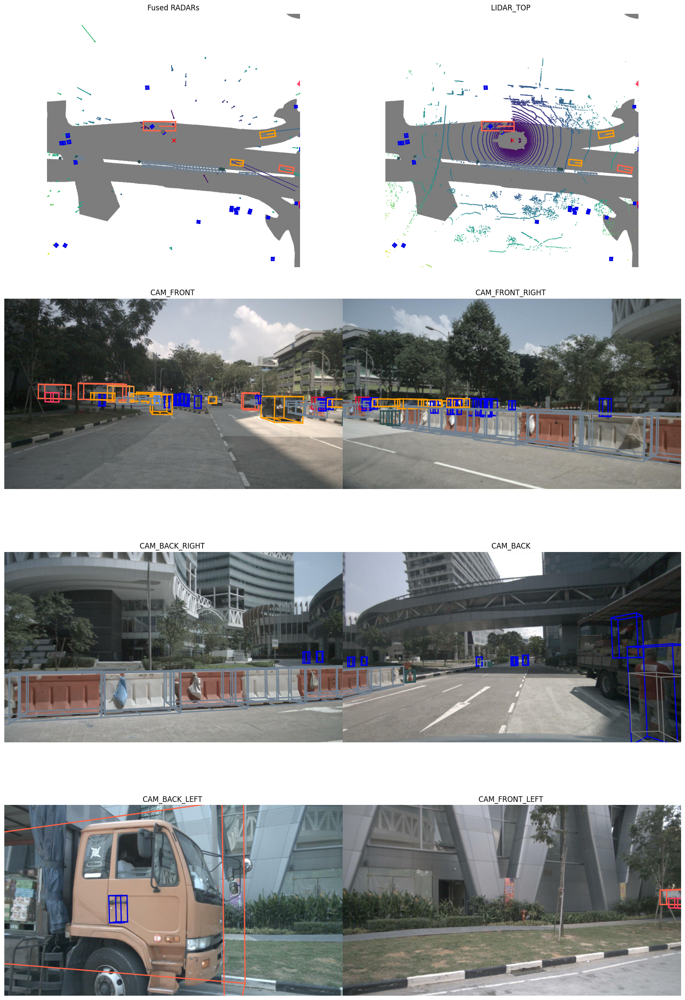


=== Visualizing dangerous frame Rank 3 (t = 1.55 s) ===


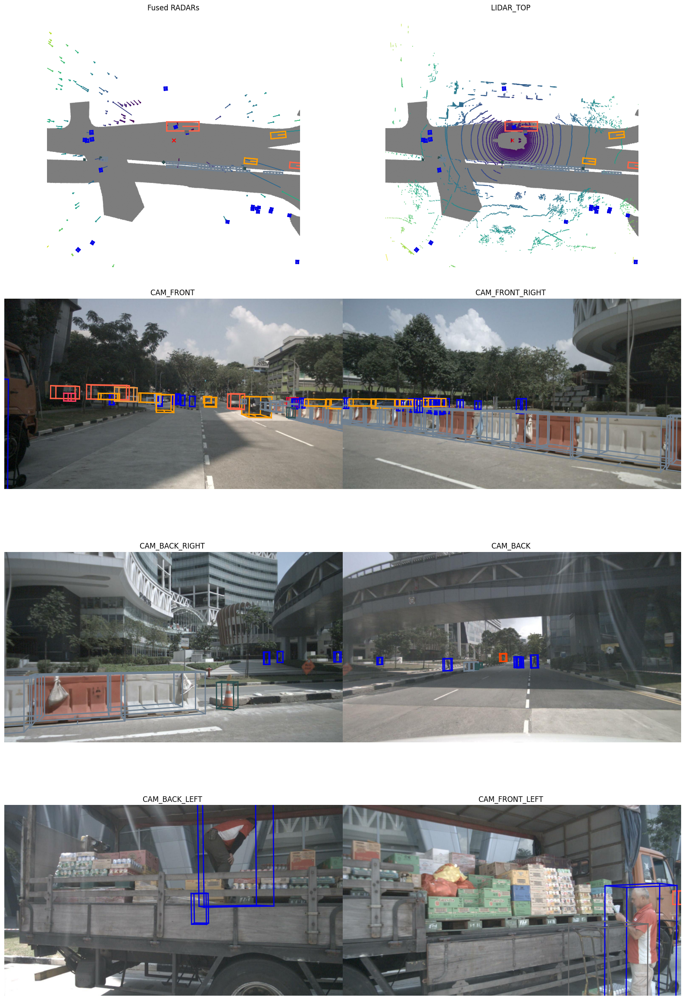

In [ ]:
for rank in range(top_k):
    i = int(top_idx[rank])
    token = sample_tokens[i]

    print(f"\n=== Visualizing dangerous frame Rank {rank+1} (t = {time_used[i]:.2f} s) ===")
    nusc.render_sample(token)



=== CAM_FRONT for dangerous frame Rank 1 (t = 2.05 s) ===


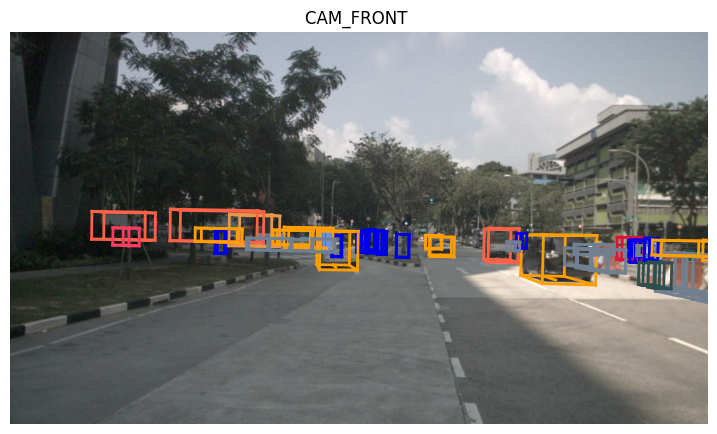


=== CAM_FRONT for dangerous frame Rank 2 (t = 2.50 s) ===


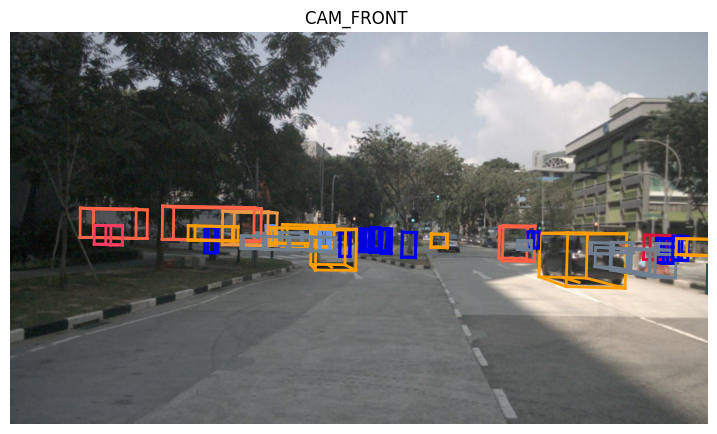


=== CAM_FRONT for dangerous frame Rank 3 (t = 1.55 s) ===


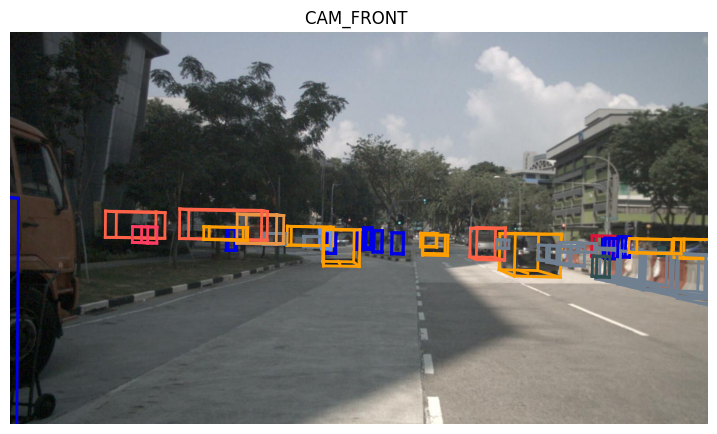

In [ ]:
for rank in range(top_k):
    i = int(top_idx[rank])
    token = sample_tokens[i]
    sample = nusc.get('sample', token)
    cam_token = sample['data']['CAM_FRONT']

    print(f"\n=== CAM_FRONT for dangerous frame Rank {rank+1} (t = {time_used[i]:.2f} s) ===")
    nusc.render_sample_data(cam_token, with_anns=True)


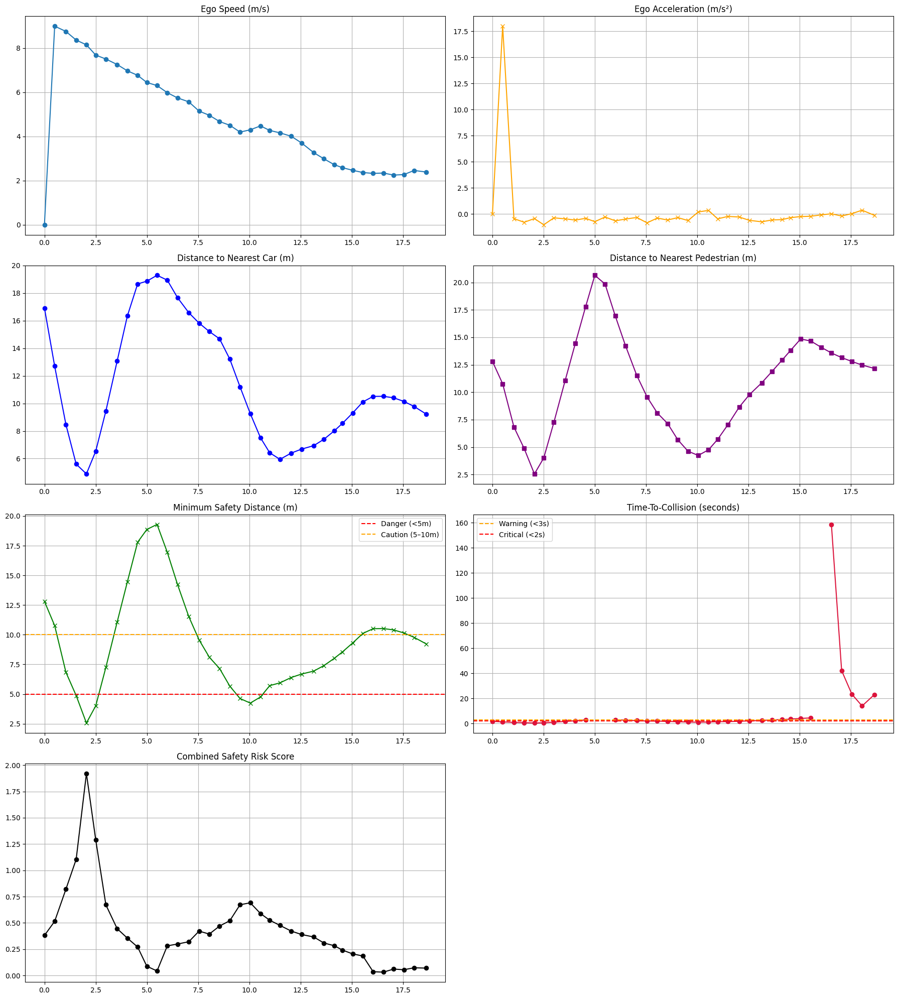

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Make sure all arrays are same length
n = min(len(relative_time), len(ego_speeds), len(ego_accels),
        len(dist_car), len(dist_ped), len(dist_min), len(ttc_values), len(risk_scores))

time = np.array(relative_time[:n])
speed = np.array(ego_speeds[:n])
accel = np.array(ego_accels[:n])
car_dist = np.array(dist_car[:n])
ped_dist = np.array(dist_ped[:n])
min_dist = np.array(dist_min[:n])
ttc = np.array(ttc_values[:n])
risk = np.array(risk_scores[:n])

# Infinite TTC replaced for plotting
ttc_plot = np.copy(ttc)
ttc_plot[~np.isfinite(ttc_plot)] = np.nan   # show gaps where TTC is infinite

# Create a mega-dashboard
fig, axs = plt.subplots(4, 2, figsize=(18, 20))
axs = axs.ravel()

# 1. Speed
axs[0].plot(time, speed, marker='o')
axs[0].set_title("Ego Speed (m/s)")
axs[0].grid(True)

# 2. Acceleration
axs[1].plot(time, accel, marker='x', color='orange')
axs[1].set_title("Ego Acceleration (m/s²)")
axs[1].grid(True)

# 3. Distance to Cars
axs[2].plot(time, car_dist, marker='o', color='blue')
axs[2].set_title("Distance to Nearest Car (m)")
axs[2].grid(True)

# 4. Distance to Pedestrians
axs[3].plot(time, ped_dist, marker='s', color='purple')
axs[3].set_title("Distance to Nearest Pedestrian (m)")
axs[3].grid(True)

# 5. Minimum Distance + danger bands
axs[4].plot(time, min_dist, marker='x', color='green')
axs[4].axhline(5, color='red', linestyle='--', label='Danger (<5m)')
axs[4].axhline(10, color='orange', linestyle='--', label='Caution (5–10m)')
axs[4].set_title("Minimum Safety Distance (m)")
axs[4].legend()
axs[4].grid(True)

# 6. TTC
axs[5].plot(time, ttc_plot, marker='o', color='crimson')
axs[5].axhline(3, color='orange', linestyle='--', label='Warning (<3s)')
axs[5].axhline(2, color='red', linestyle='--', label='Critical (<2s)')
axs[5].set_title("Time-To-Collision (seconds)")
axs[5].legend()
axs[5].grid(True)

# 7. Risk Score
axs[6].plot(time, risk, marker='o', color='black')
axs[6].set_title("Combined Safety Risk Score")
axs[6].grid(True)

# 8. Empty slot (we can use later)
axs[7].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np

# Make sure all arrays are same length
n = min(len(time_arr), len(dist_min_arr), len(ttc_arr), len(risk_scores))
time_used = time_arr[:n]
dist_used = dist_min_arr[:n]
ttc_used = ttc_arr[:n]
risk_used = risk_scores[:n]

# Sort by highest risk (descending)
top_idx = np.argsort(-risk_used)

top_k = 5

rows = []

for rank in range(top_k):
    i = int(top_idx[rank])

    # Label based on safety
    if dist_used[i] < 5 or (np.isfinite(ttc_used[i]) and ttc_used[i] < 2):
        level = "CRITICAL"
    elif dist_used[i] < 10 or (np.isfinite(ttc_used[i]) and ttc_used[i] < 3):
        level = "WARNING"
    else:
        level = "SAFE"

    rows.append({
        "Rank": rank + 1,
        "Time (s)": round(time_used[i], 2),
        "Min Distance (m)": round(dist_used[i], 2),
        "TTC (s)": round(ttc_used[i], 2) if np.isfinite(ttc_used[i]) else "∞",
        "Risk Score": round(risk_used[i], 3),
        "Safety Level": level
    })

# Convert to DataFrame
danger_df = pd.DataFrame(rows)

danger_df


,Rank,Time (s),Min Distance (m),TTC (s),Risk Score,Safety Level
0,1,2.05,2.56,0.34,1.920,CRITICAL
1,2,2.50,4.01,0.54,1.290,CRITICAL
2,3,1.55,4.87,0.62,1.105,CRITICAL
3,4,1.05,6.83,0.82,0.821,CRITICAL
4,5,10.05,4.24,0.97,0.691,CRITICAL



=== Dangerous frame RANK 1 (index 4) ===
Time   : 2.05 s
Risk   : 1.920
Min dist: 2.56 m
TTC    : 0.34 s


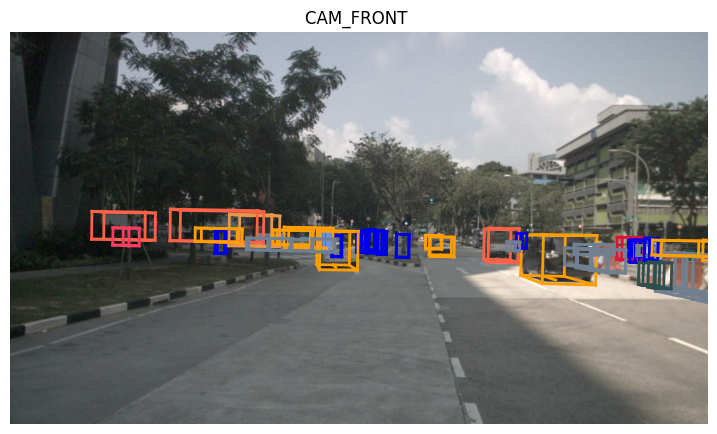


=== Dangerous frame RANK 2 (index 5) ===
Time   : 2.50 s
Risk   : 1.290
Min dist: 4.01 m
TTC    : 0.54 s


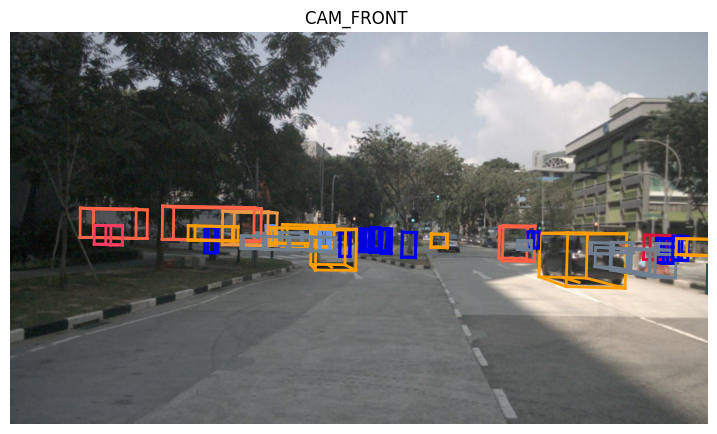


=== Dangerous frame RANK 3 (index 3) ===
Time   : 1.55 s
Risk   : 1.105
Min dist: 4.87 m
TTC    : 0.62 s


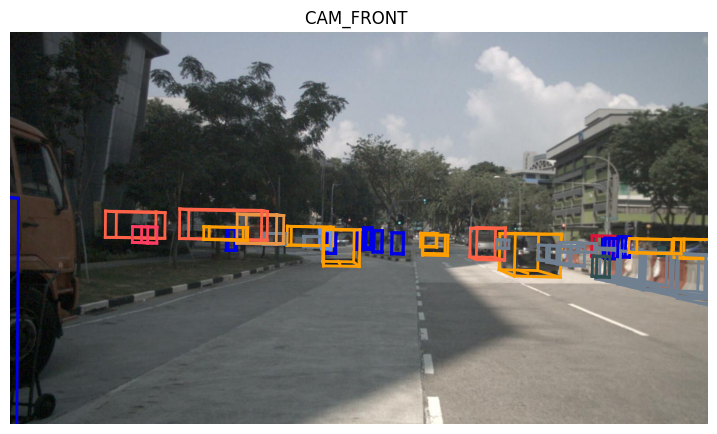


=== Dangerous frame RANK 4 (index 2) ===
Time   : 1.05 s
Risk   : 0.821
Min dist: 6.83 m
TTC    : 0.82 s


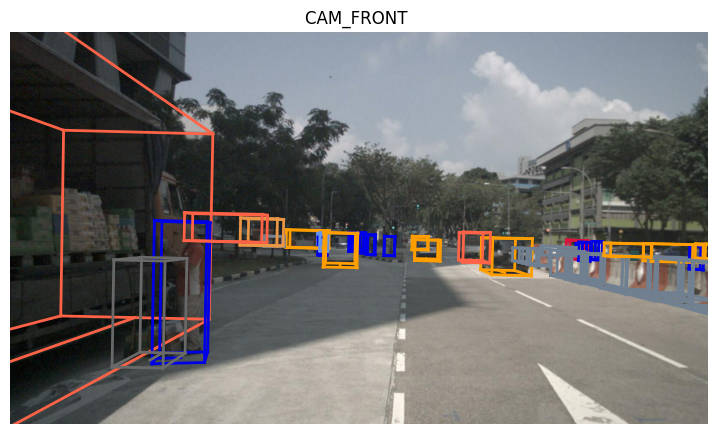


=== Dangerous frame RANK 5 (index 20) ===
Time   : 10.05 s
Risk   : 0.691
Min dist: 4.24 m
TTC    : 0.97 s


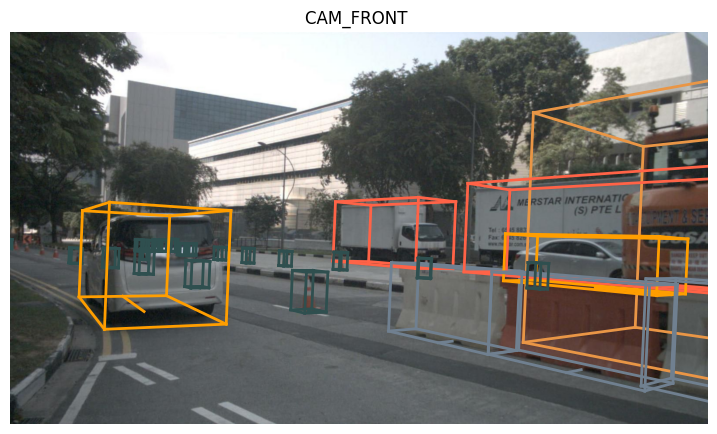

In [ ]:
top_k = 5  # how many dangerous frames to visualize

# Rebuild aligned arrays (just to be safe)
n = min(len(sample_tokens), len(risk_scores))
risk_used = np.array(risk_scores[:n])

# Get indices of top-k highest risk frames
top_idx = np.argsort(-risk_used)[:top_k]

for rank, i in enumerate(top_idx, start=1):
    sample_token = sample_tokens[i]
    sample = nusc.get('sample', sample_token)
    cam_token = sample['data']['CAM_FRONT']

    print(f"\n=== Dangerous frame RANK {rank} (index {i}) ===")
    print(f"Time   : {time_arr[i]:.2f} s")
    print(f"Risk   : {risk_used[i]:.3f}")
    print(f"Min dist: {dist_min_arr[i]:.2f} m")
    print(f"TTC    : {ttc_arr[i]:.2f} s" if np.isfinite(ttc_arr[i]) else "TTC    : ∞ s")

    # Render CAM_FRONT with annotations
    nusc.render_sample_data(cam_token, with_anns=True)
